# Base de dados PRF - DATATRAN

Link: https://www.gov.br/prf/pt-br/acesso-a-informacao/dados-abertos/dados-abertos-da-prf

# Base do IBGE - SHP CIDADES

Link: https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/15774-malhas.html

# Base do IBGE - SHP UNIDADES DA FEDERAÇÃO

Link: https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/15774-malhas.html

In [55]:
#importação da biblioteca pandas para leitura dos dados
import pandas as pd
import os
import geopandas as gpd
import matplotlib.pyplot as plt
from splot.esda import lisa_cluster
from esda.moran import Moran_Local
from pysal.lib import weights
from shapely.ops import unary_union
from scipy.ndimage import gaussian_filter
import numpy as np
import matplotlib.colors as mcolors

In [37]:
# Caminho para a pasta que contém os arquivos CSV
pasta = '..\\Base de dados\\datatran\\'

# Lista para armazenar cada DataFrame lido
dataframes = []

# Iterar sobre cada arquivo na pasta especificada
for arquivo in os.listdir(pasta):
    # Verificar se o arquivo é um CSV
    if arquivo.endswith('.csv'):
        caminho_completo = os.path.join(pasta, arquivo)
        
        encodings = ['utf-8', 'iso-8859-1', 'cp1252']  # Lista comuns de codificações
        for enc in encodings:
            try:
                df = pd.read_csv(caminho_completo, encoding=enc)
                print(f"Sucesso com a codificação: {enc}")
                break
            except UnicodeDecodeError:
                print(f"Falha com a codificação: {enc}")
        
        
        # Converter a coluna de data para o formato padrão, ajuste 'date_column_name' para o nome da sua coluna de data
        df['data_inversa'] = pd.to_datetime(df['data_inversa'], errors='coerce')
        
        dataframes.append(df)

# Combinar todos os DataFrames na lista em um único DataFrame
df_final = pd.concat(dataframes, ignore_index=True)
df_final

Sucesso com a codificação: utf-8
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1
Sucesso com a codificação: utf-8
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1
Falha com a codificação: utf-8
Sucesso com a codificação: iso-8859-1


,Unnamed: 0,id,data_inversa,dia_semana,horario,uf,br,km,municipio,causa_acidente,tipo_acidente,classificacao_acidente,fase_dia,sentido_via,condicao_metereologica,tipo_pista,tracado_via,uso_solo,pessoas,mortos,feridos_leves,feridos_graves,ilesos,ignorados,feridos,veiculos,latitude,longitude,regional,delegacia,uop
0,0.0,8.0,2017-01-01,domingo,00:00:00,PR,376.0,112.0,PARANAVAI,Fenômenos da Natureza,Queda de ocupante de veículo,Com Vítimas Feridas,Plena Noite,Crescente,Chuva,Simples,Reta,Não,1,0,0,1,0,0,1,1,-23.098807,-52.387894,SR-PR,DEL7-7,UOP05-PR
1,1.0,9.0,2017-01-01,domingo,00:01:00,SC,101.0,234.0,PALHOCA,Falta de Atenção à Condução,Colisão com objeto estático,Sem Vítimas,Plena Noite,Crescente,Chuva,Dupla,Curva,Não,1,0,0,0,1,0,0,1,-27.810100,-48.635700,SR-SC,DEL8-1,UOP02-SC
2,2.0,11.0,2017-01-01,domingo,00:00:00,PR,153.0,56.9,SANTO ANTONIO DA PLATINA,Animais na Pista,Capotamento,Com Vítimas Feridas,Plena Noite,Decrescente,Garoa-Chuvisco,Simples,Reta,Não,2,0,2,0,0,0,2,1,-23.369520,309.935131,SR-PR,DEL7-7,UOP07-PR
3,3.0,12.0,2017-01-01,domingo,00:00:00,GO,153.0,435.0,ANAPOLIS,Avarias e-ou desgaste excessivo no pneu,Tombamento,Com Vítimas Feridas,Plena Noite,Decrescente,Céu Claro,Dupla,Reta,Sim,1,0,0,1,0,0,1,1,-16.274737,-48.969090,SR-GO,DEL1-2,UOP01-GO
4,4.0,13.0,2017-01-01,domingo,00:00:00,SC,280.0,77.3,CORUPA,Ingestão de Álcool,Saída de leito carroçável,Com Vítimas Feridas,Plena Noite,Decrescente,Chuva,Simples,Não Informado,Não,1,0,1,0,0,0,1,1,-26.446752,-49.201670,SR-SC,DEL8-6,UOP03-SC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
473980,NaN,595704.0,2024-03-09,sábado,09:00:00,RS,470.0,231.0,CARLOS BARBOSA,Acessar a via sem observar a presença dos outr...,Colisão lateral mesmo sentido,Com Vítimas Feridas,Pleno dia,Crescente,Céu Claro,Dupla,Reta,Sim,2,0,1,0,1,0,1,2,-29.235792,-51.511934,NaN,NaN,NaN
473981,NaN,595930.0,2024-03-10,domingo,19:19:00,ES,101.0,144.0,LINHARES,Reação tardia ou ineficiente do condutor,Colisão traseira,Com Vítimas Feridas,Plena Noite,Crescente,Nublado,Múltipla,Reta,Sim,3,0,1,1,1,0,2,2,-19.342866,-40.063857,NaN,NaN,NaN
473982,NaN,595964.0,2024-03-02,sábado,14:30:00,MG,381.0,456.0,BELO HORIZONTE,Condutor deixou de manter distância do veículo...,Engavetamento,Com Vítimas Feridas,Pleno dia,Crescente,Chuva,Dupla,Reta,Sim,7,0,2,0,4,1,2,5,-19.858630,-43.912925,NaN,NaN,NaN
473983,NaN,596029.0,2024-03-16,sábado,06:00:00,RS,116.0,297.0,GUAIBA,Acessar a via sem observar a presença dos outr...,Colisão transversal,Com Vítimas Fatais,Amanhecer,Crescente,Céu Claro,Dupla,Reta,Não,4,1,0,0,3,0,0,2,-30.097531,-51.343029,NaN,NaN,NaN


In [39]:
#Informação geral dos tipos de variáveis
#Auxilia na hora da proposição das análises exploratórias
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 473985 entries, 0 to 473984
Data columns (total 31 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   Unnamed: 0              89563 non-null   float64       
 1   id                      473985 non-null  float64       
 2   data_inversa            473985 non-null  datetime64[ns]
 3   dia_semana              473985 non-null  object        
 4   horario                 473985 non-null  object        
 5   uf                      473985 non-null  object        
 6   br                      472975 non-null  float64       
 7   km                      472975 non-null  float64       
 8   municipio               473985 non-null  object        
 9   causa_acidente          473985 non-null  object        
 10  tipo_acidente           473985 non-null  object        
 11  classificacao_acidente  473985 non-null  object        
 12  fase_dia                473985

In [ ]:
#Exportação dos dados em planilha excel (xlsx) para visualização fora do documento jupyter
df_final.to_excel("Dados_finais_datatran.xlsx")

    CD_MUN                 NM_MUN SIGLA_UF  AREA_KM2  \
0  1100015  Alta Floresta D'Oeste       RO  7067.127   
1  1100023              Ariquemes       RO  4426.571   
2  1100031                 Cabixi       RO  1314.352   
3  1100049                 Cacoal       RO  3793.000   
4  1100056             Cerejeiras       RO  2783.300   

                                            geometry  
0  POLYGON ((-62.00806 -12.13379, -62.00784 -12.2...  
1  POLYGON ((-63.17933 -10.13924, -63.17746 -10.1...  
2  POLYGON ((-60.52408 -13.32137, -60.37162 -13.3...  
3  POLYGON ((-61.35502 -11.50452, -61.35524 -11.5...  
4  POLYGON ((-60.82135 -13.11910, -60.81773 -13.1...  


<Axes: >

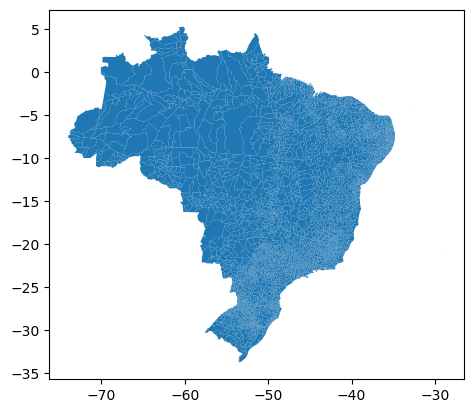

In [40]:
#carregando a base de municípios baixados no site do IBGE
shapefile_path = '..\\shp\\municipios Brasil\\BR_Municipios_2022.shp'
gdf_brasil = gpd.read_file(shapefile_path)

# Visualizar os dados
print(gdf_brasil.head())
gdf_brasil.plot()

In [41]:
# Convertendo df para um GeoDataFrame
gdf_acidentes = gpd.GeoDataFrame(
    df_final, geometry=gpd.points_from_xy(df_final.longitude, df_final.latitude),
    crs="EPSG:4326"  
)

In [42]:
# Realizando um spatial join entre o shapefile e os pontos do GeoDataFrame
geo_brasil_acidentes = gpd.sjoin(gdf_brasil, gdf_acidentes, how="left", op='contains')
geo_brasil_acidentes

C:\Users\kaiog\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
C:\Users\kaiog\AppData\Local\Temp\ipykernel_15480\3797868621.py:2: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4674
Right CRS: EPSG:4326

  geo_brasil_acidentes = gpd.sjoin(gdf_brasil, gdf_acidentes, how="left", op='contains')


,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry,index_right,Unnamed: 0,id,data_inversa,dia_semana,horario,uf,br,km,municipio,causa_acidente,tipo_acidente,classificacao_acidente,fase_dia,sentido_via,condicao_metereologica,tipo_pista,tracado_via,uso_solo,pessoas,mortos,feridos_leves,feridos_graves,ilesos,ignorados,feridos,veiculos,latitude,longitude,regional,delegacia,uop
0,1100015,Alta Floresta D'Oeste,RO,7067.127,"POLYGON ((-62.00806 -12.13379, -62.00784 -12.2...",NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.17746 -10.1...",50716.0,50716.0,58005.0,2017-07-29,sábado,08:00:00,RO,364.0,453.0,JARU,Defeito na Via,Saída de leito carroçável,Com Vítimas Feridas,Pleno dia,Decrescente,Céu Claro,Simples,Reta,Não,4.0,0.0,1.0,0.0,3.0,0.0,1.0,1.0,-10.284500,-62.674400,SR-RO,DEL21-3,UOP02-RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.17746 -10.1...",151572.0,NaN,174832.0,2018-11-29,quinta-feira,21:30:00,RO,364.0,453.0,JARU,Defeito na Via,Saída de leito carroçável,Com Vítimas Feridas,Plena Noite,Crescente,Nevoeiro/Neblina,Simples,Reta,Não,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,-10.283412,-62.675800,SR-RO,DEL21/3,UOP02/RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.17746 -10.1...",130281.0,NaN,150538.0,2018-07-27,sexta-feira,08:30:00,RO,364.0,453.5,ARIQUEMES,Não guardar distância de segurança,Colisão traseira,Sem Vítimas,Pleno dia,Crescente,Céu Claro,Simples,Não Informado,Não,4.0,0.0,0.0,0.0,3.0,1.0,0.0,3.0,-10.280610,-62.679853,SR-RO,DEL21/3,UOP02/RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.17746 -10.1...",325569.0,NaN,373810.0,2021-07-30,sexta-feira,08:40:00,RO,364.0,454.0,CACAULANDIA,Reação tardia ou ineficiente do condutor,Colisão frontal,Com Vítimas Feridas,Pleno dia,Crescente,Céu Claro,Simples,Reta,Não,4.0,0.0,0.0,2.0,2.0,0.0,2.0,3.0,-10.278059,-62.683065,SR-RO,UOP02,DEL03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.01573 -16.0...",49430.0,49430.0,56541.0,2017-07-23,domingo,15:10:00,DF,20.0,34.0,BRASILIA,Falta de Atenção à Condução,Saída de leito carroçável,Com Vítimas Feridas,Pleno dia,Decrescente,Céu Claro,Dupla,Reta,Não,3.0,0.0,1.0,0.0,1.0,1.0,1.0,2.0,-15.581672,-47.551065,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.01573 -16.0...",3093.0,3093.0,3689.0,2017-01-14,sábado,12:05:00,DF,20.0,45.0,BRASILIA,Falta de Atenção à Condução,Capotamento,Com Vítimas Feridas,Pleno dia,Crescente,Céu Claro,Dupla,Não Informado,Não,2.0,0.0,2.0,0.0,0.0,0.0,2.0,1.0,-15.552599,-47.549257,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.01573 -16.0...",11638.0,11638.0,13409.0,2017-02-19,domingo,20:00:00,DF,20.0,17.0,BRASILIA,Falta de Atenção à Condução,Colisão lateral,Sem Vítimas,Plena Noite,Crescente,Céu Claro,Dupla,Reta,Sim,2.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,-15.552237,-47.549663,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.01573 -16.0...",408373.0,NaN,481635.0,2022-10-19,quarta-feira,20:26:00,DF,20.0,45.0,BRASILIA,Velocidade Incompatível,Saída de leito carroçável,Sem Vítimas,Plena Noite,Crescente,Céu Claro,Dupla,Reta,Não,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,-15.575328,-47.476139,SPRF-DF,DEL02-DF,UOP01-DEL02-DF


In [7]:
# Verificar geometrias inválidas
print(gdf_brasil[gdf_brasil.geometry.is_valid == False])

Empty GeoDataFrame
Columns: [CD_MUN, NM_MUN, SIGLA_UF, AREA_KM2, geometry]
Index: []


In [43]:
# Correção das geometrias inválidas
gdf2 = gdf_brasil
gdf2['geometry'] = gdf2.geometry.buffer(0)
gdf2

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry
0,1100015,Alta Floresta D'Oeste,RO,7067.127,"POLYGON ((-62.00806 -12.13379, -62.00784 -12.2..."
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.17746 -10.1..."
2,1100031,Cabixi,RO,1314.352,"POLYGON ((-60.52408 -13.32137, -60.37162 -13.3..."
3,1100049,Cacoal,RO,3793.000,"POLYGON ((-61.35502 -11.50452, -61.35524 -11.5..."
4,1100056,Cerejeiras,RO,2783.300,"POLYGON ((-60.82135 -13.11910, -60.81773 -13.1..."
...,...,...,...,...,...
5567,5222005,Vianópolis,GO,954.115,"POLYGON ((-48.31126 -16.84221, -48.31170 -16.8..."
5568,5222054,Vicentinópolis,GO,733.794,"POLYGON ((-49.73613 -17.74427, -49.73624 -17.7..."
5569,5222203,Vila Boa,GO,1052.593,"POLYGON ((-47.07780 -15.06364, -47.07799 -15.0..."
5570,5222302,Vila Propício,GO,2181.593,"POLYGON ((-48.58713 -15.31847, -48.58714 -15.3..."


<Axes: >

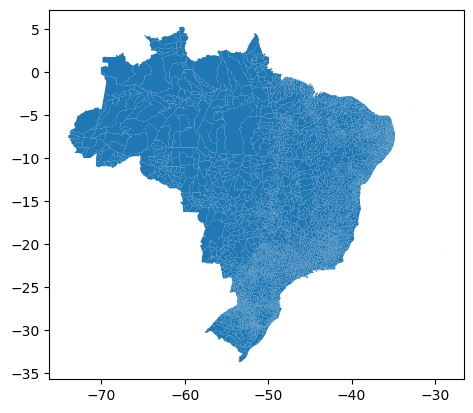

In [44]:
# Simplificando as geometrias e garantindo desempenho na horas de plotar as análises
gdf2['geometry'] = gdf2.geometry.simplify(tolerance=0.01, preserve_topology=True)
gdf2.plot()

C:\Users\kaiog\anaconda3\Lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
C:\Users\kaiog\AppData\Local\Temp\ipykernel_15480\926304509.py:2: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4674
Right CRS: EPSG:4326

  geo_brasil_acidentes = gpd.sjoin(gdf2, gdf_acidentes, how="left", op='contains')


<Axes: >

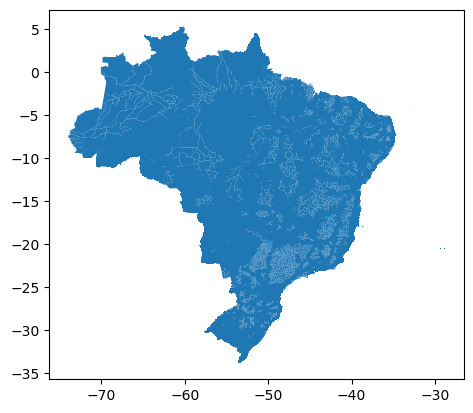

In [45]:
# Realizando um spatial join entre o shapefile e os pontos do GeoDataFrame
geo_brasil_acidentes = gpd.sjoin(gdf2, gdf_acidentes, how="left", op='contains')
geo_brasil_acidentes.plot()

In [46]:
#Tratamento dos dados apóes a união espacial 
geo_brasil_acidentes['feridos_graves'] = geo_brasil_acidentes['feridos_graves'].fillna(0)
geo_brasil_acidentes['mortos'] = geo_brasil_acidentes['mortos'].fillna(0)
geo_brasil_acidentes['feridos_graves'] = geo_brasil_acidentes['feridos_graves'].fillna(0)
geo_brasil_acidentes['ilesos'] = geo_brasil_acidentes['ilesos'].fillna(0)
geo_brasil_acidentes['ignorados'] = geo_brasil_acidentes['ignorados'].fillna(0)
geo_brasil_acidentes['feridos'] = geo_brasil_acidentes['feridos'].fillna(0)
geo_brasil_acidentes['veiculos'] = geo_brasil_acidentes['veiculos'].fillna(0)
geo_brasil_acidentes

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry,index_right,Unnamed: 0,id,data_inversa,dia_semana,horario,uf,br,km,municipio,causa_acidente,tipo_acidente,classificacao_acidente,fase_dia,sentido_via,condicao_metereologica,tipo_pista,tracado_via,uso_solo,pessoas,mortos,feridos_leves,feridos_graves,ilesos,ignorados,feridos,veiculos,latitude,longitude,regional,delegacia,uop
0,1100015,Alta Floresta D'Oeste,RO,7067.127,"POLYGON ((-62.00806 -12.13379, -62.00060 -12.7...",NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.14632 -10.0...",50716.0,50716.0,58005.0,2017-07-29,sábado,08:00:00,RO,364.0,453.0,JARU,Defeito na Via,Saída de leito carroçável,Com Vítimas Feridas,Pleno dia,Decrescente,Céu Claro,Simples,Reta,Não,4.0,0.0,1.0,0.0,3.0,0.0,1.0,1.0,-10.284500,-62.674400,SR-RO,DEL21-3,UOP02-RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.14632 -10.0...",151572.0,NaN,174832.0,2018-11-29,quinta-feira,21:30:00,RO,364.0,453.0,JARU,Defeito na Via,Saída de leito carroçável,Com Vítimas Feridas,Plena Noite,Crescente,Nevoeiro/Neblina,Simples,Reta,Não,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,-10.283412,-62.675800,SR-RO,DEL21/3,UOP02/RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.14632 -10.0...",130281.0,NaN,150538.0,2018-07-27,sexta-feira,08:30:00,RO,364.0,453.5,ARIQUEMES,Não guardar distância de segurança,Colisão traseira,Sem Vítimas,Pleno dia,Crescente,Céu Claro,Simples,Não Informado,Não,4.0,0.0,0.0,0.0,3.0,1.0,0.0,3.0,-10.280610,-62.679853,SR-RO,DEL21/3,UOP02/RO
1,1100023,Ariquemes,RO,4426.571,"POLYGON ((-63.17933 -10.13924, -63.14632 -10.0...",325569.0,NaN,373810.0,2021-07-30,sexta-feira,08:40:00,RO,364.0,454.0,CACAULANDIA,Reação tardia ou ineficiente do condutor,Colisão frontal,Com Vítimas Feridas,Pleno dia,Crescente,Céu Claro,Simples,Reta,Não,4.0,0.0,0.0,2.0,2.0,0.0,2.0,3.0,-10.278059,-62.683065,SR-RO,UOP02,DEL03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.27781 -16.0...",49430.0,49430.0,56541.0,2017-07-23,domingo,15:10:00,DF,20.0,34.0,BRASILIA,Falta de Atenção à Condução,Saída de leito carroçável,Com Vítimas Feridas,Pleno dia,Decrescente,Céu Claro,Dupla,Reta,Não,3.0,0.0,1.0,0.0,1.0,1.0,1.0,2.0,-15.581672,-47.551065,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.27781 -16.0...",3093.0,3093.0,3689.0,2017-01-14,sábado,12:05:00,DF,20.0,45.0,BRASILIA,Falta de Atenção à Condução,Capotamento,Com Vítimas Feridas,Pleno dia,Crescente,Céu Claro,Dupla,Não Informado,Não,2.0,0.0,2.0,0.0,0.0,0.0,2.0,1.0,-15.552599,-47.549257,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.27781 -16.0...",11638.0,11638.0,13409.0,2017-02-19,domingo,20:00:00,DF,20.0,17.0,BRASILIA,Falta de Atenção à Condução,Colisão lateral,Sem Vítimas,Plena Noite,Crescente,Céu Claro,Dupla,Reta,Sim,2.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,-15.552237,-47.549663,SR-DF,UOP04-DF,NaN
5571,5300108,Brasília,DF,5760.784,"POLYGON ((-48.01472 -16.04996, -48.27781 -16.0...",408373.0,NaN,481635.0,2022-10-19,quarta-feira,20:26:00,DF,20.0,45.0,BRASILIA,Velocidade Incompatível,Saída de leito carroçável,Sem Vítimas,Plena Noite,Crescente,Céu Claro,Dupla,Reta,Não,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,-15.575328,-47.476139,SPRF-DF,DEL02-DF,UOP01-DEL02-DF


<Axes: >

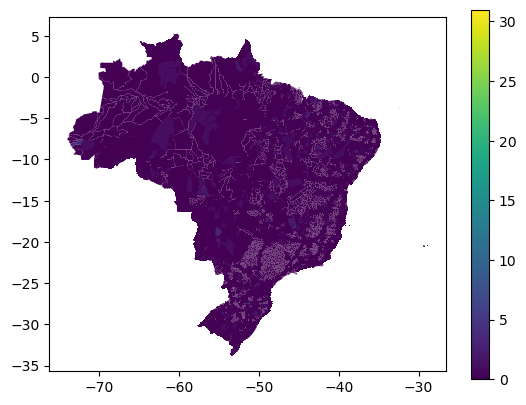

In [12]:
#Primeira visualização dos dados, quase não dá para ver diferença devido a extensão do país e agrupamento dos dados
#em tornoda base
#Indica que análises mais regionais são necessárias
geo_brasil_acidentes.plot(column='feridos_graves', legend=True, cmap='viridis', vmin=0)

### Análises por UF e município

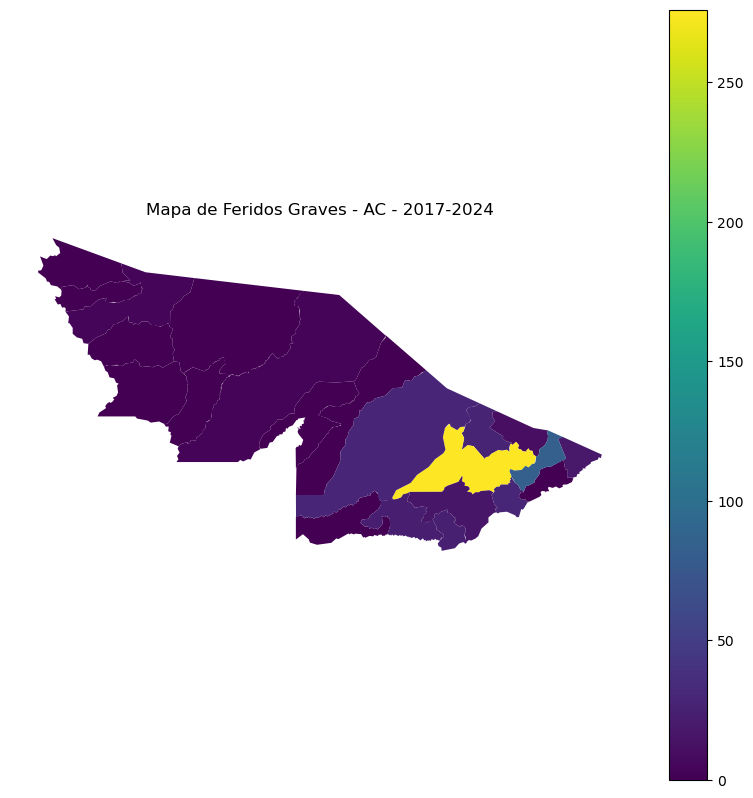

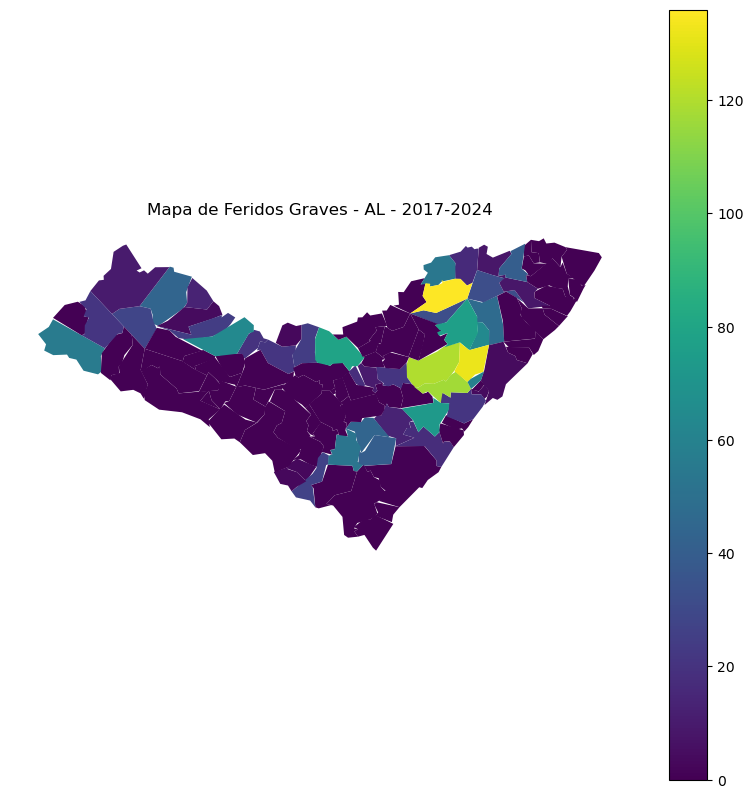

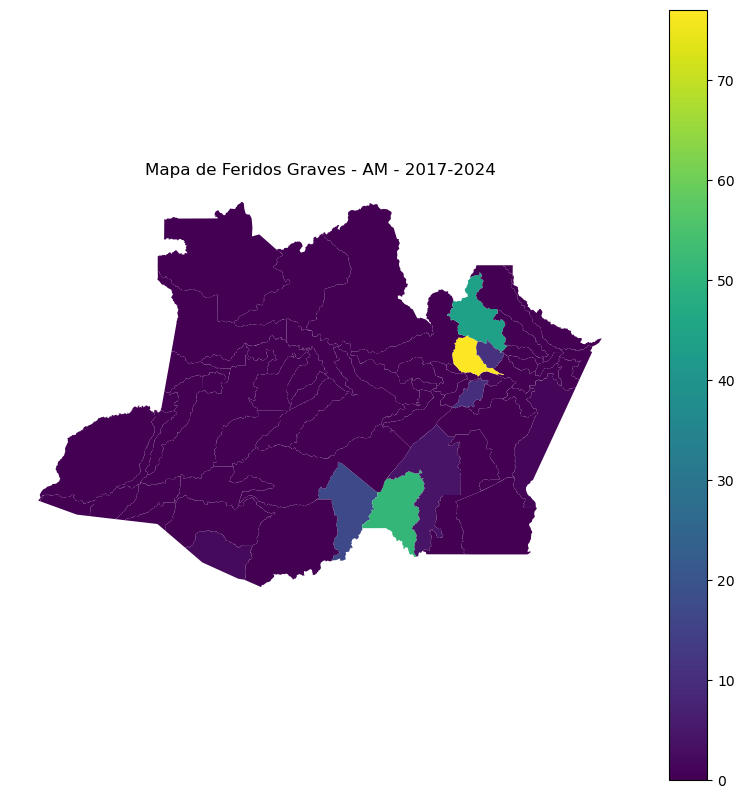

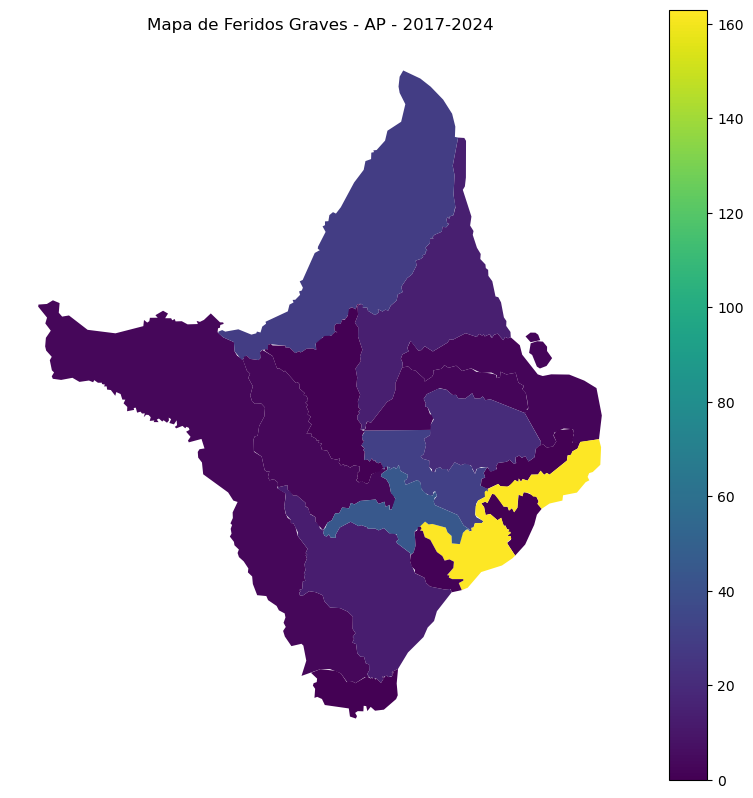

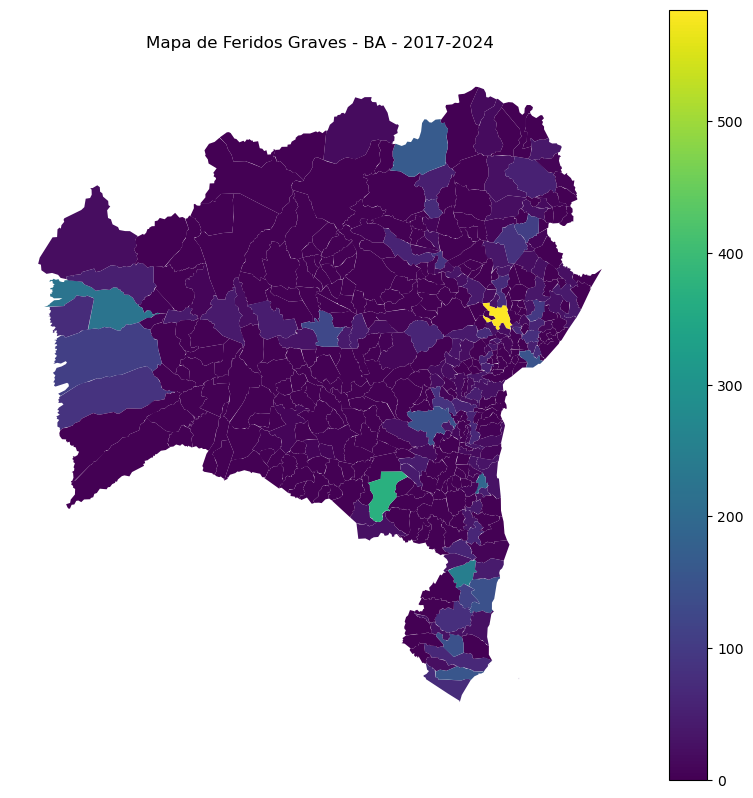

...

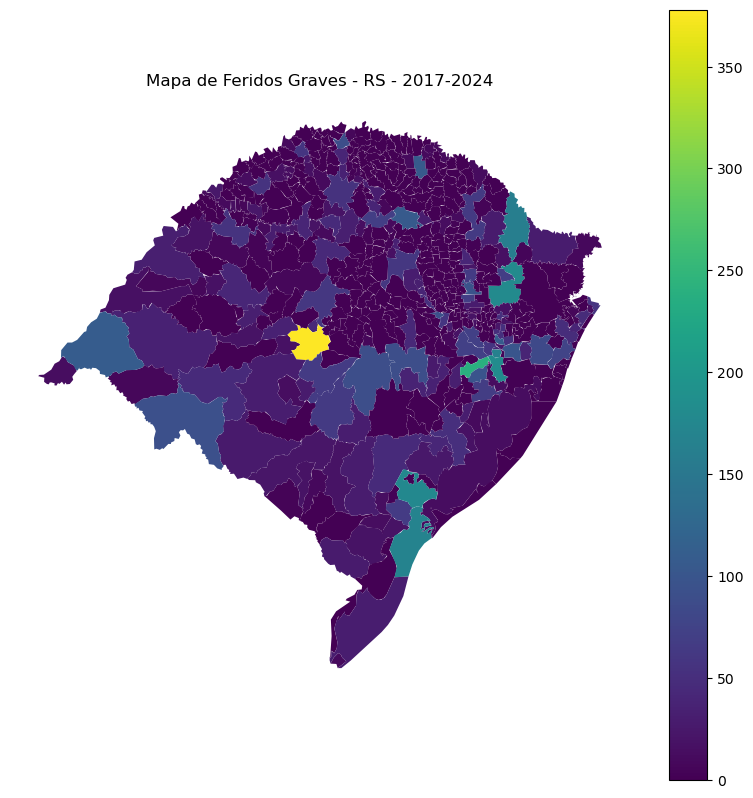

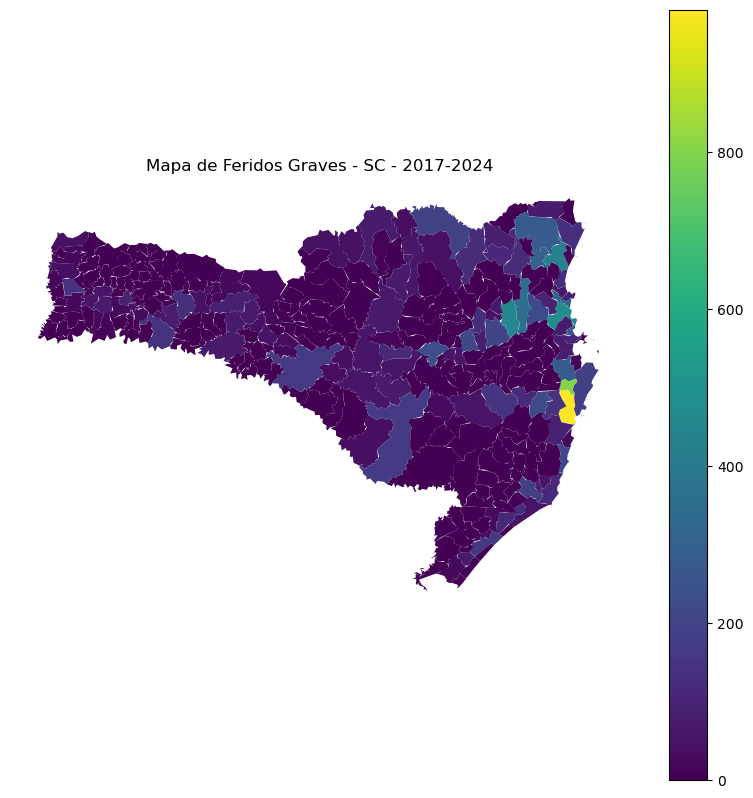

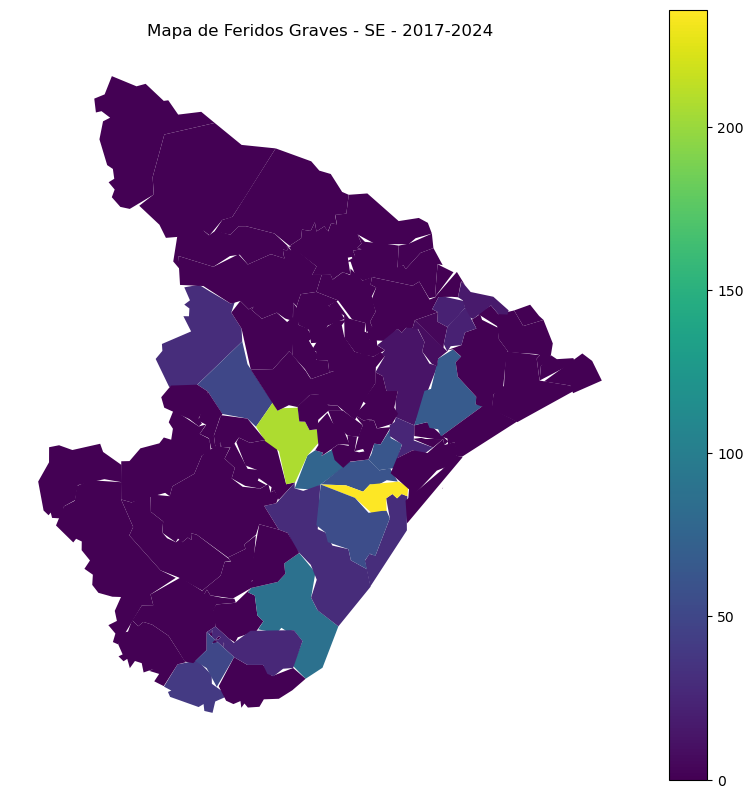

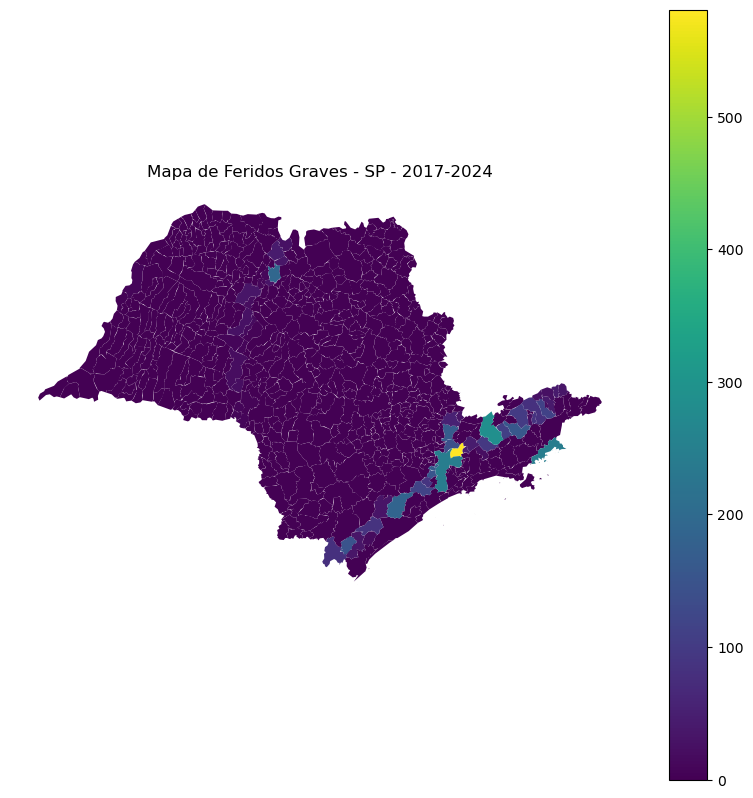

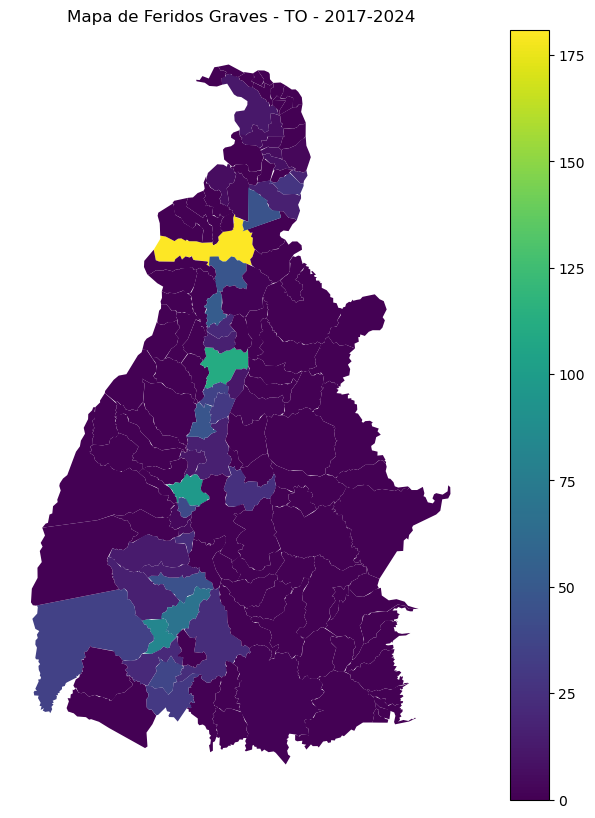

In [47]:
#Número total de feridos entre 2017 e 2024 por estado e muncípio

# Primeiro, preencher valores ausentes com zero
geo_brasil_acidentes['feridos_graves'] = geo_brasil_acidentes['feridos_graves'].fillna(0)

# Agrupar por 'SIGLA_UF' e 'NM_MUN' (nome do município), e somar os valores de 'feridos_graves'
geo_brasil_acidentes_grouped = geo_brasil_acidentes.groupby(['SIGLA_UF', 'NM_MUN', 'geometry']).agg({
    'feridos_graves': 'sum'
}).reset_index()

# Verificar quais estados estão disponíveis
estados = geo_brasil_acidentes_grouped['SIGLA_UF'].unique()

for estado in estados:
    # Filtrar o GeoDataFrame agrupado para o estado atual
    gdf_estado = geo_brasil_acidentes_grouped[geo_brasil_acidentes_grouped['SIGLA_UF'] == estado]

    # Criar um GeoDataFrame apenas com os dados deste estado
    gdf_estado_geo = gpd.GeoDataFrame(gdf_estado, geometry='geometry')
    
    # Criar o plot
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf_estado_geo.plot(
        column='feridos_graves',
        legend=True,
        cmap='viridis',
        ax=ax
    )
    ax.set_title(f'Mapa de Feridos Graves - {estado} - 2017-2024')
    ax.axis('off')  # Esconder os eixos

    # Exibir o plot
    plt.show()

    plt.close(fig)  # Fechar a figura após salvar para liberar memória

In [16]:
#Exportação dos dados em formato csv
geo_brasil_acidentes.to_csv("geo_brasil_acidentes_datatran.csv")

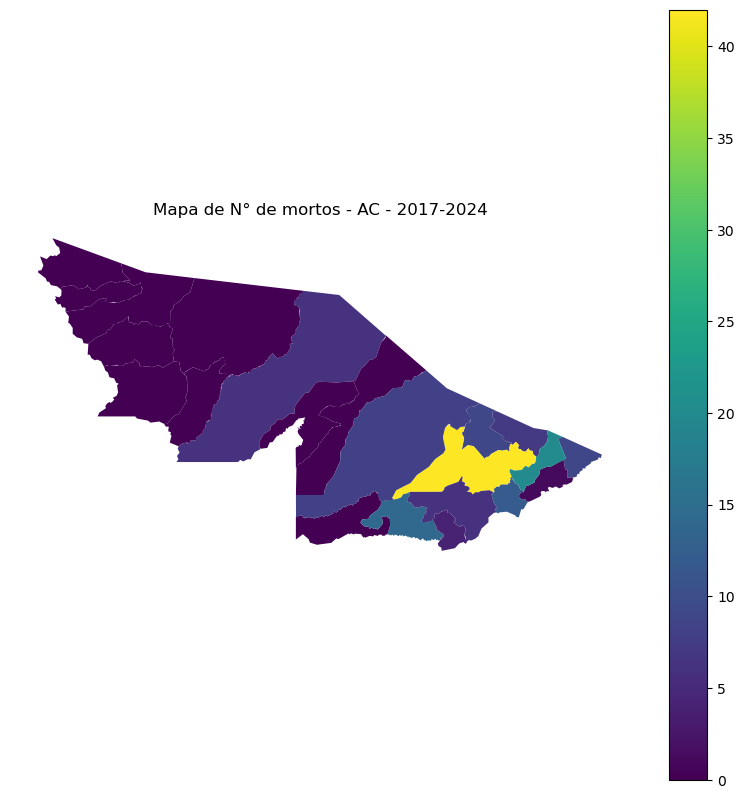

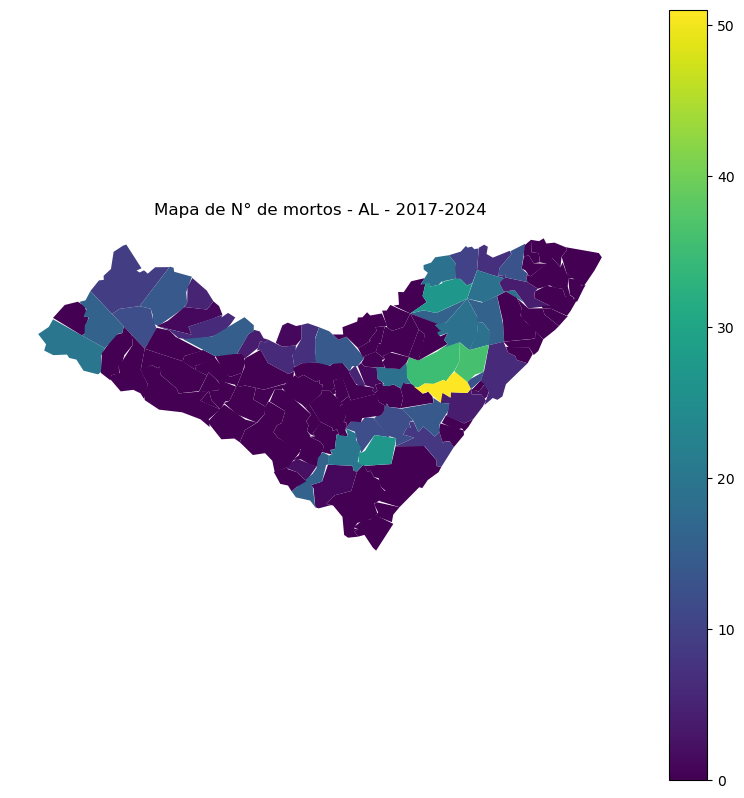

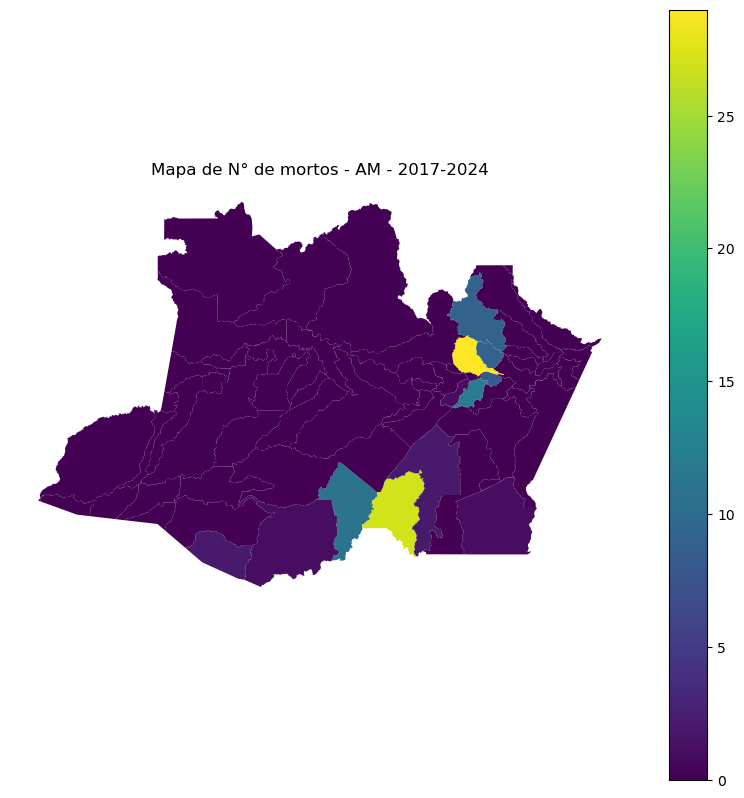

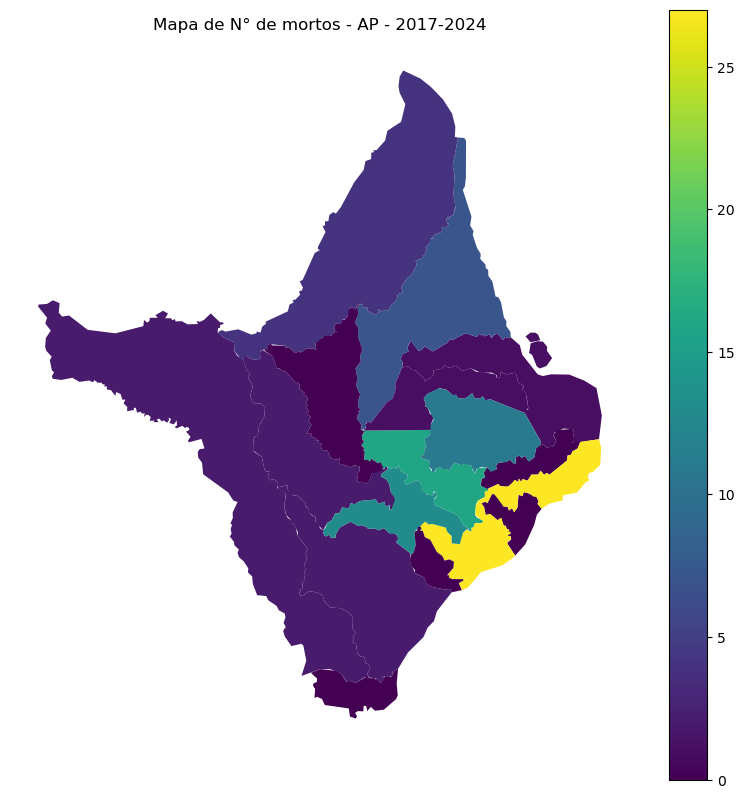

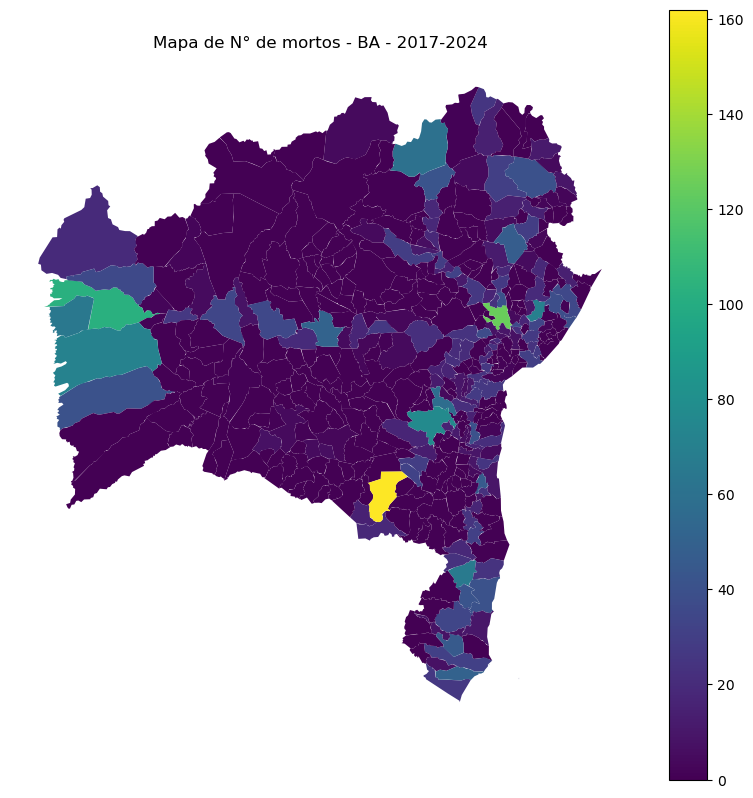

...

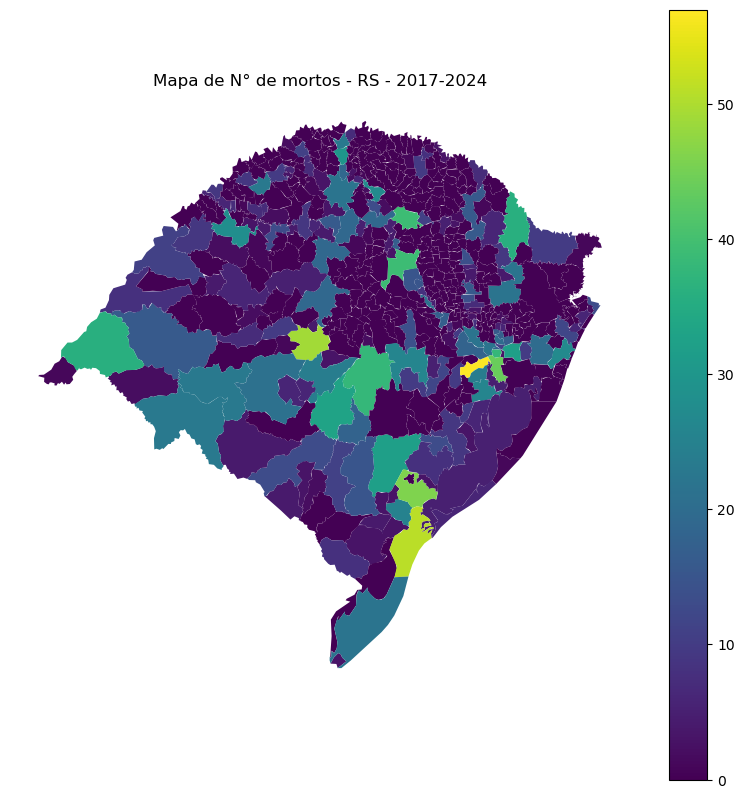

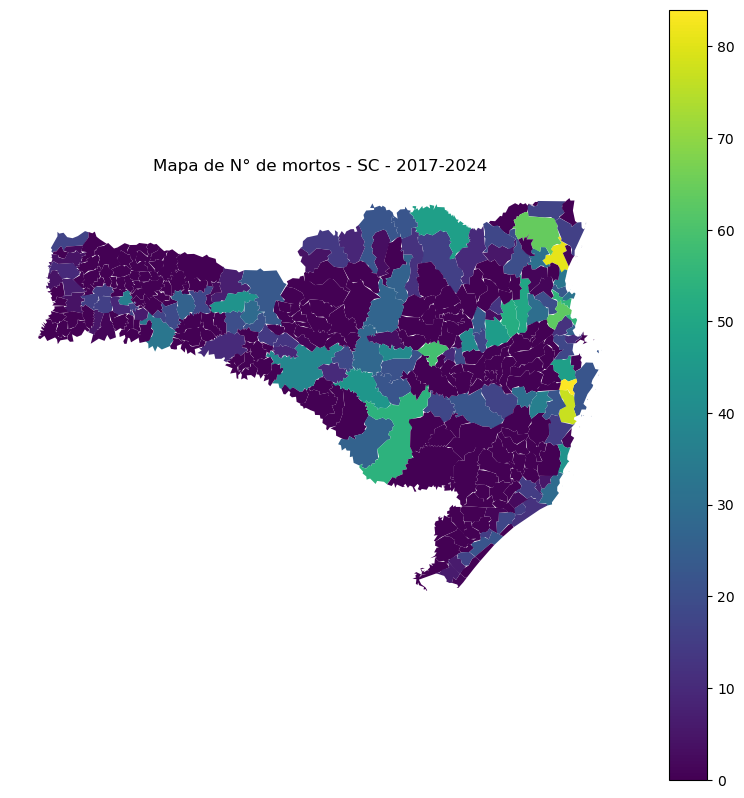

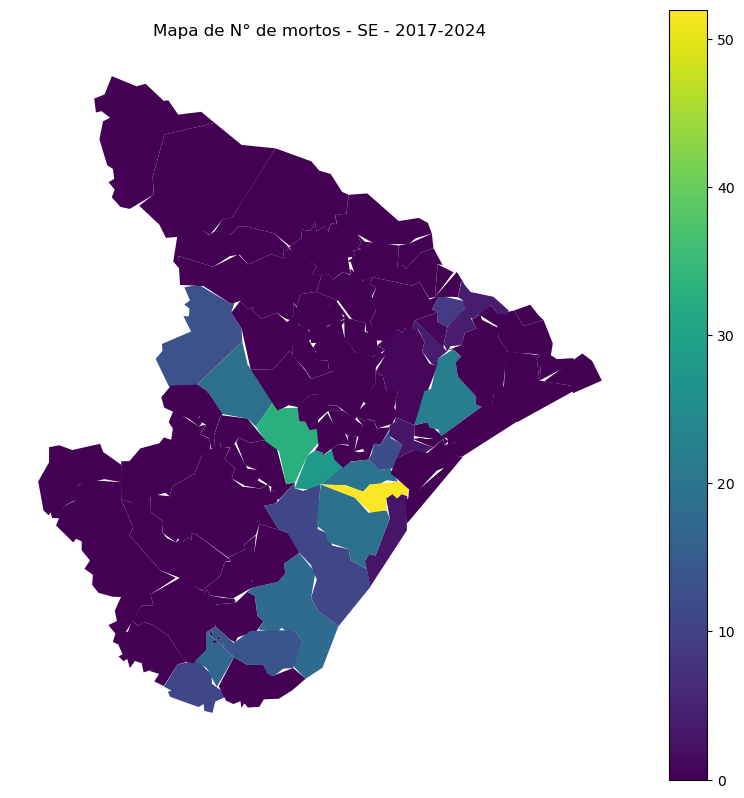

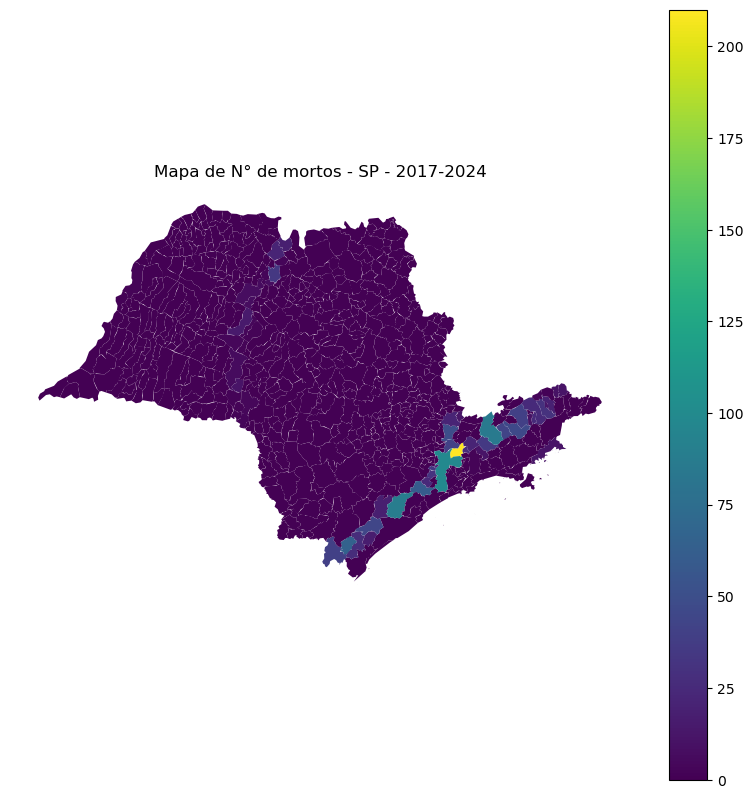

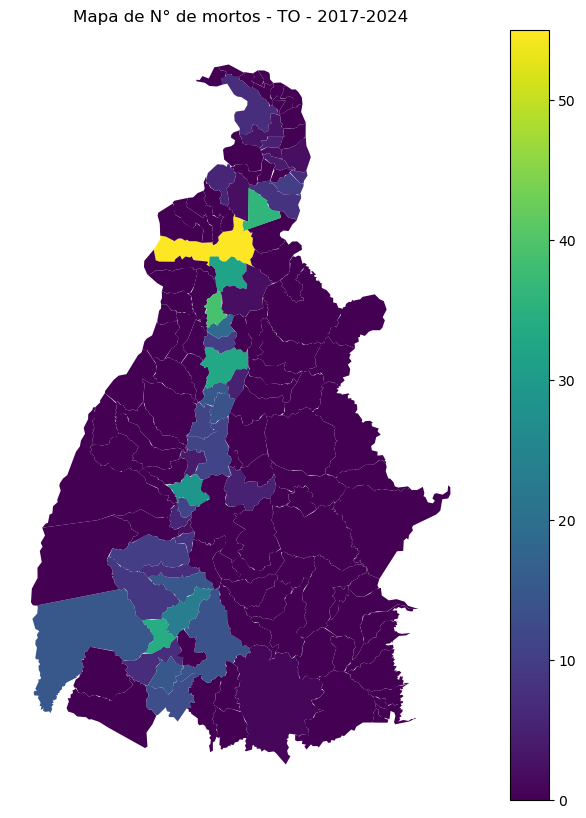

In [22]:
#Número total de mortos entre 2017 e 2024 por estado e muncípio

# Primeiro, preencher valores ausentes com zero
geo_brasil_acidentes['mortos'] = geo_brasil_acidentes['mortos'].fillna(0)

# Agrupar por 'SIGLA_UF' e 'NM_MUN' (nome do município), e somar os valores de 'feridos_graves'
geo_brasil_acidentes_grouped = geo_brasil_acidentes.groupby(['SIGLA_UF', 'NM_MUN', 'geometry']).agg({
    'mortos': 'sum'
}).reset_index()

# Verificar quais estados estão disponíveis
estados = geo_brasil_acidentes_grouped['SIGLA_UF'].unique()

for estado in estados:
    # Filtrar o GeoDataFrame agrupado para o estado atual
    gdf_estado = geo_brasil_acidentes_grouped[geo_brasil_acidentes_grouped['SIGLA_UF'] == estado]

    # Criar um GeoDataFrame apenas com os dados deste estado
    gdf_estado_geo = gpd.GeoDataFrame(gdf_estado, geometry='geometry')

    # Criar o plot
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf_estado_geo.plot(
        column='mortos',
        legend=True,
        cmap='viridis',
        ax=ax
    )
    ax.set_title(f'Mapa de N° de mortos - {estado} - 2017-2024')
    ax.axis('off')  # Esconder os eixos

    # Exibir o plot
    plt.show()

    plt.close(fig)  # Fechar a figura após salvar para liberar memória

- Aparentemente existe um forte relação entre os mortos e feridos na regiões seguimentadas pelas principais rodovias federais (dados do datatran). 
- Interessante salientar que os próprios mapas destacaram as rodovias sem mesmo a necessidade delas estarem na plotagem. 
- Há evidências de que a quantidade de fluxos veiculares e condições operacionais podem agravar o número de mortos e feridos nessas regiões

### Cálculo do UPS (Unidade Padrão de Severidade) agregados por munício e UF

referência: https://www.gov.br/dnit/pt-br/1a-semana-do-planejamento/10ProgramadetratamentodesegmentoscriticosSS.pdf

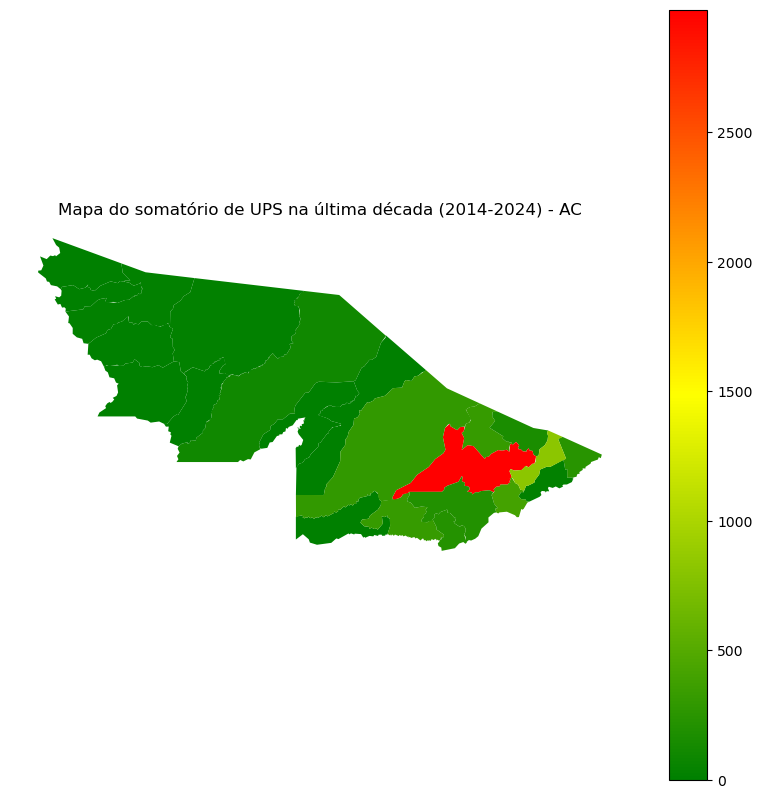

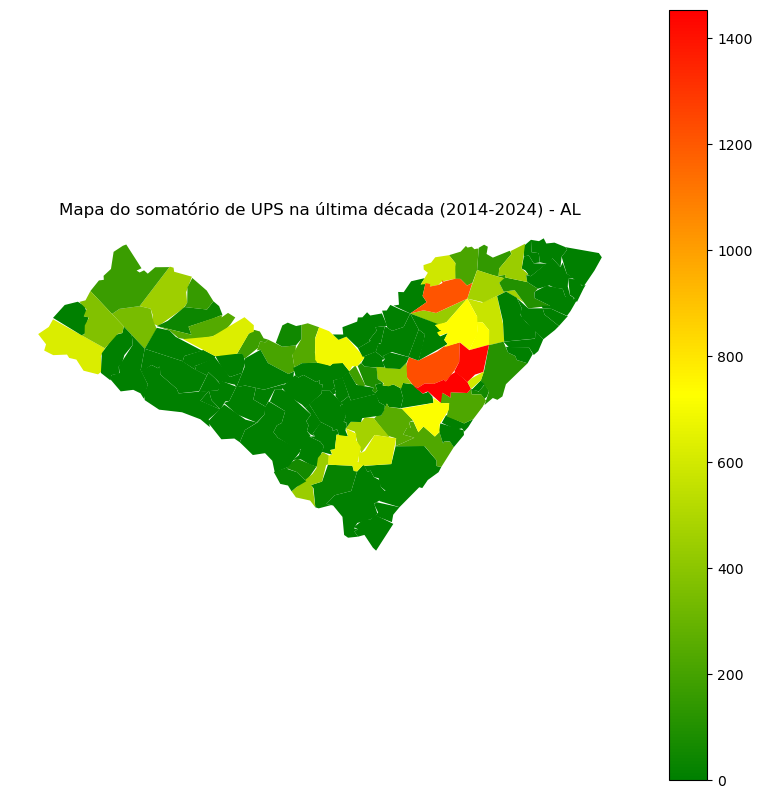

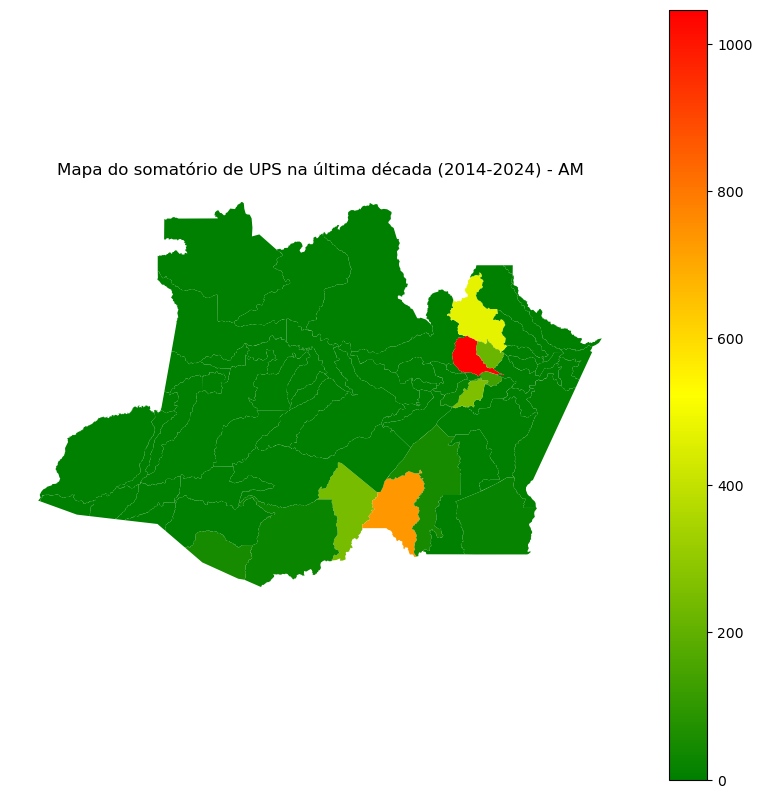

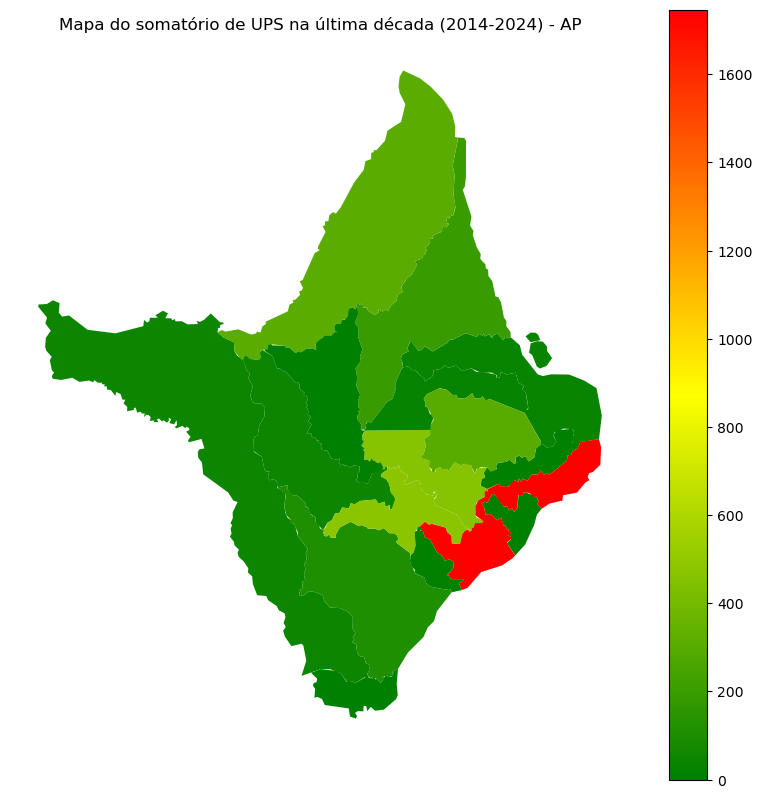

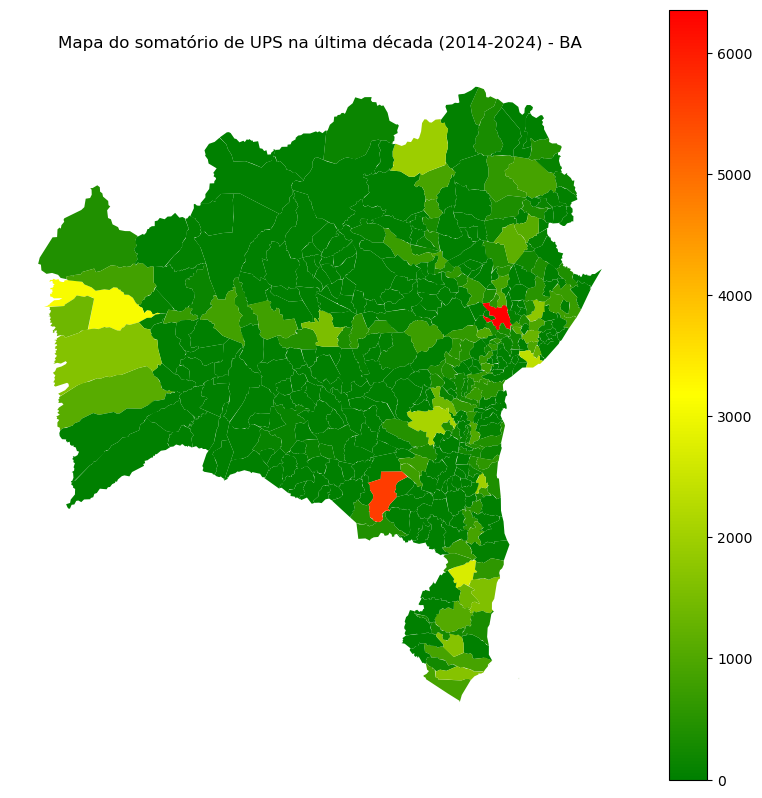

...

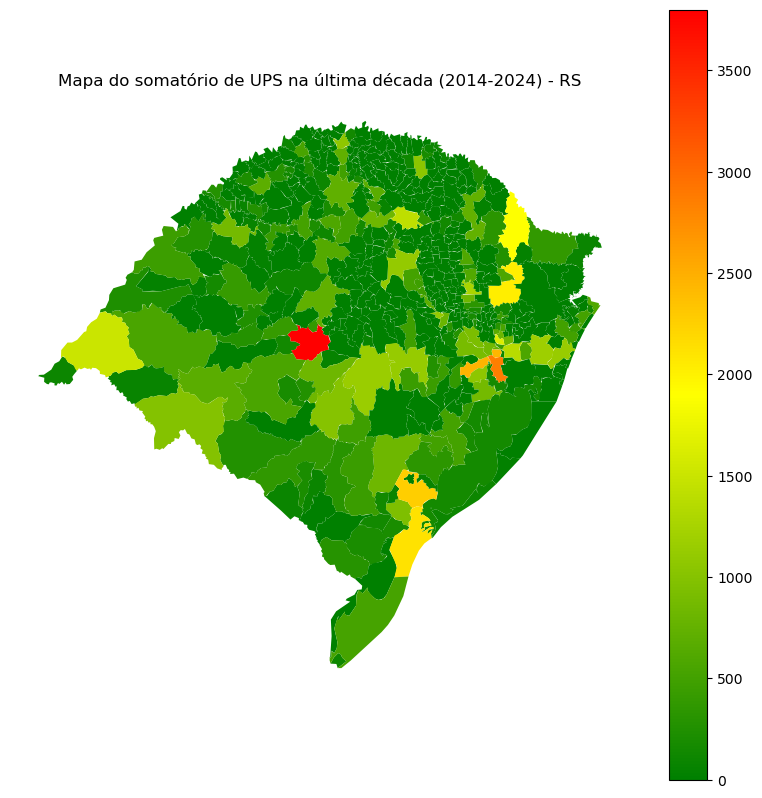

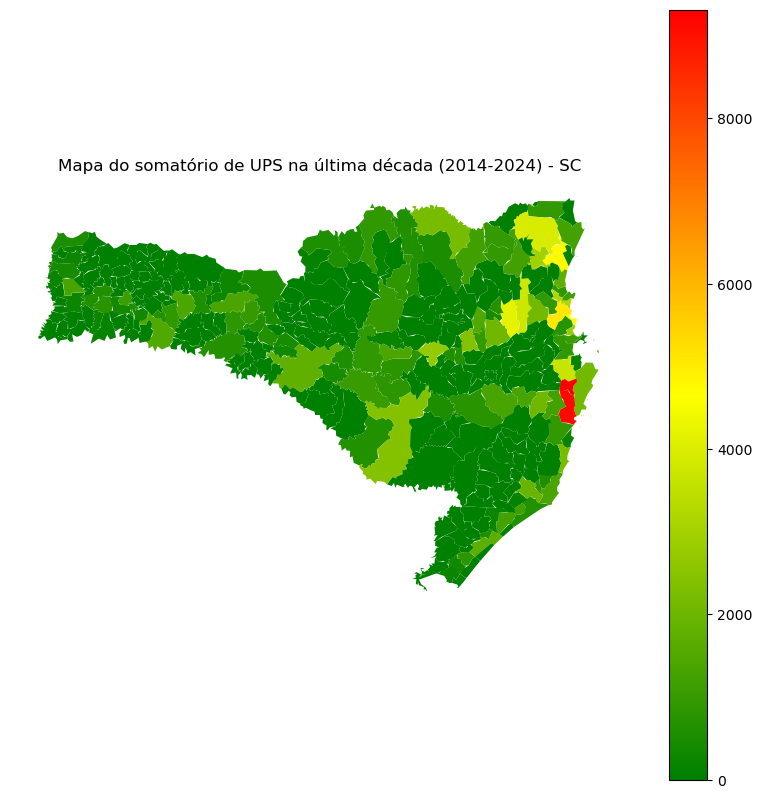

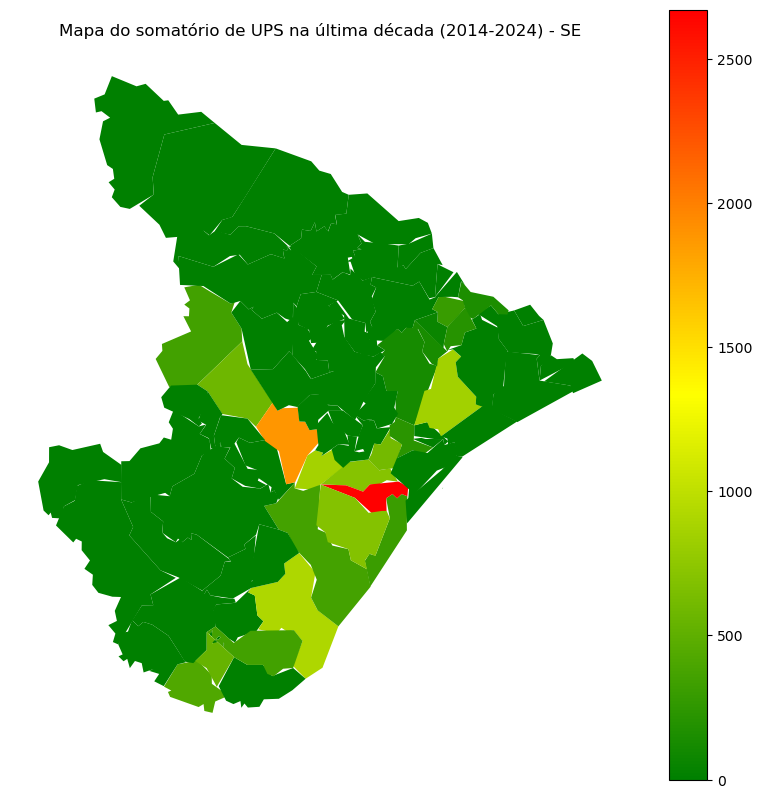

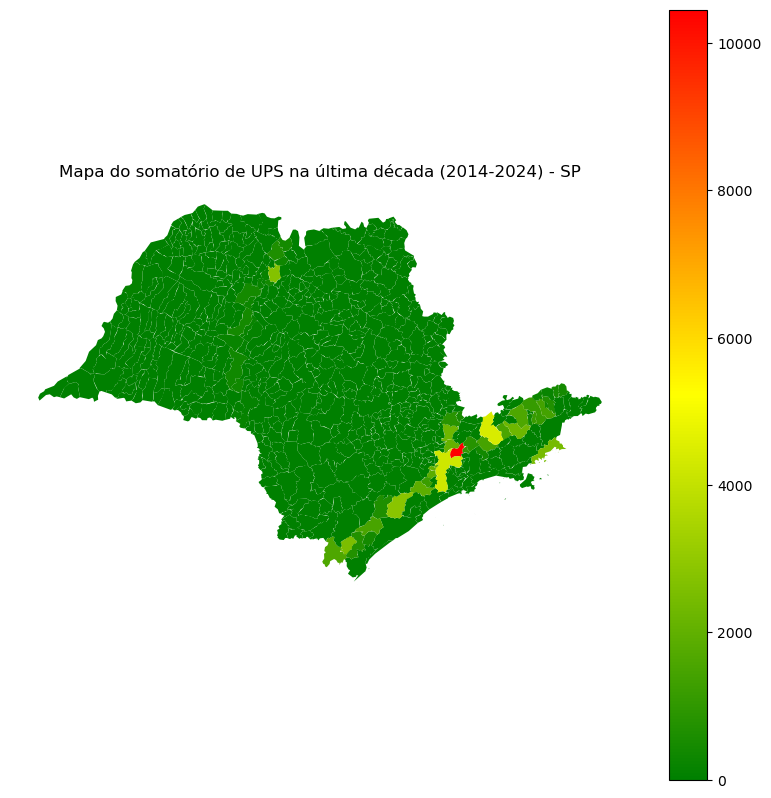

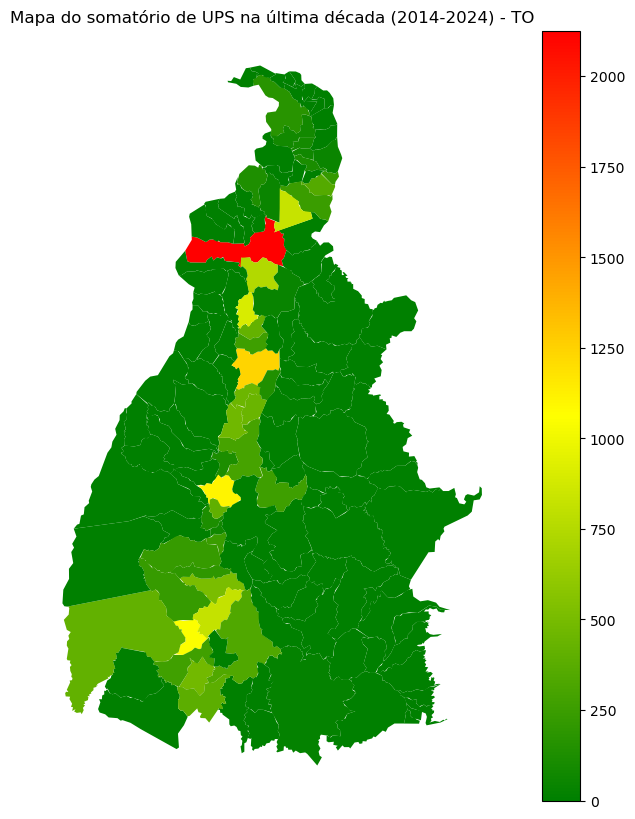

In [70]:
#Fatores de severidade Mortes: 10, Feridos graves: 5, Feridos leves: 1
fator_mortes = 13
fator_feridos_graves = 5
fator_feridos_leves = 1

# Calcular UPS para cada município
geo_brasil_acidentes['UPS'] = (
    geo_brasil_acidentes['mortos'] * fator_mortes +
    geo_brasil_acidentes['feridos_graves'] * fator_feridos_graves +
    geo_brasil_acidentes['feridos_leves'] * fator_feridos_leves
)

# Agrupar por 'SIGLA_UF', 'NM_MUN' e calcular média anual de UPS
geo_brasil_acidentes['ano'] = pd.to_datetime(geo_brasil_acidentes['data_inversa']).dt.year
geo_brasil_acidentes_grouped = geo_brasil_acidentes.groupby(['SIGLA_UF', 'NM_MUN', 'geometry']).agg({
    'UPS': 'sum'
}).reset_index()

# Definindo uma paleta de cores do verde para o vermelho
cmap = mcolors.LinearSegmentedColormap.from_list("custom_green_red", ["green", "yellow", "red"], N=256)

# Plotar mapa por estado
estados = geo_brasil_acidentes_grouped['SIGLA_UF'].unique()

for estado in estados:
    # Filtrar e agrupar dados por estado
    gdf_estado = geo_brasil_acidentes_grouped[geo_brasil_acidentes_grouped['SIGLA_UF'] == estado]

    # Criar um GeoDataFrame apenas com os dados deste estado
    gdf_estado_geo = gpd.GeoDataFrame(gdf_estado, geometry='geometry')

    # Plotar o UPS para cada município
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf_estado_geo.plot(column='UPS', legend=True, cmap=cmap, ax=ax)

    ax.set_title(f'Mapa do somatório de UPS na última década (2014-2024) - {estado}')
    ax.axis('off')  # Esconder os eixos
    plt.show()

    plt.close(fig)  # Fechar a figura após salvar para liberar memória

### Série histórica do número de mortos e feridos 2017-2024 por estado e muncípio

- Essa análise utiliza do conceito de recorte espacial
- Serão exibidos os recortes de acordo com a passagem do tempo para ficar claro as áreas de interesse

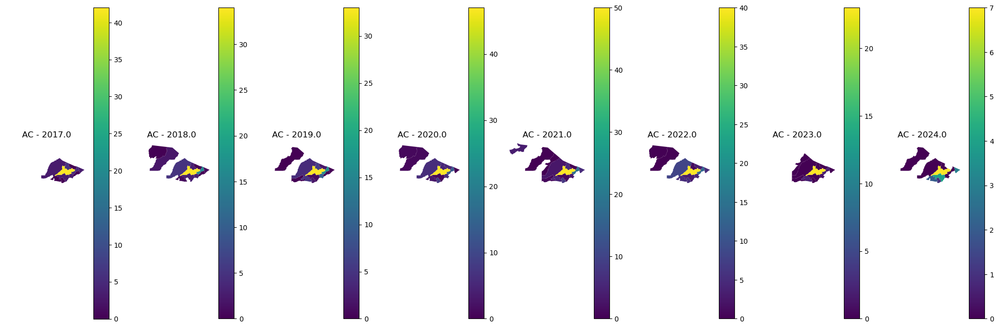

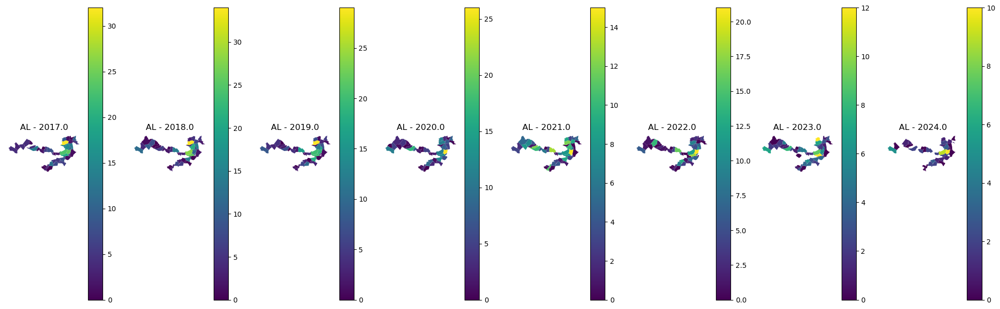

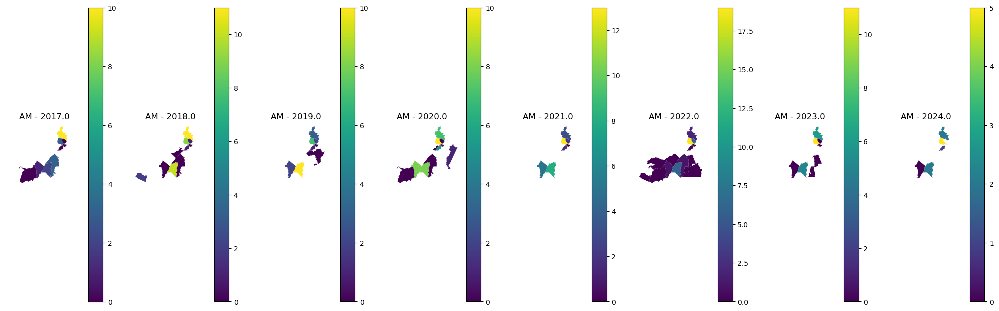

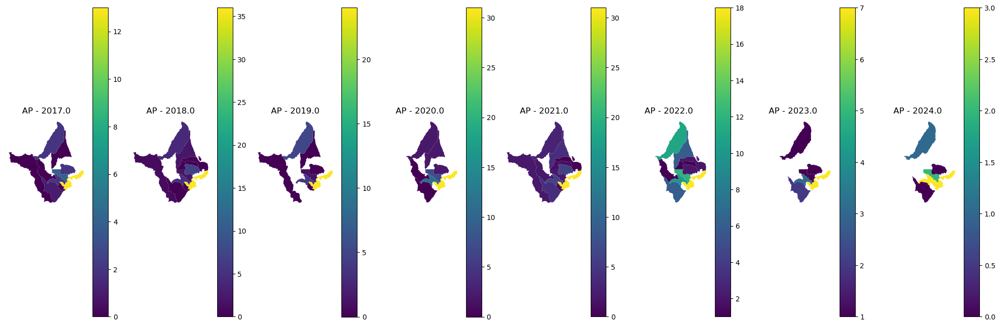

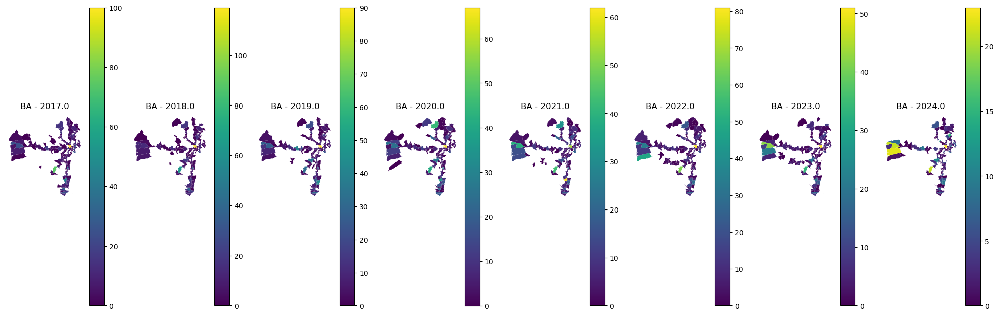

...

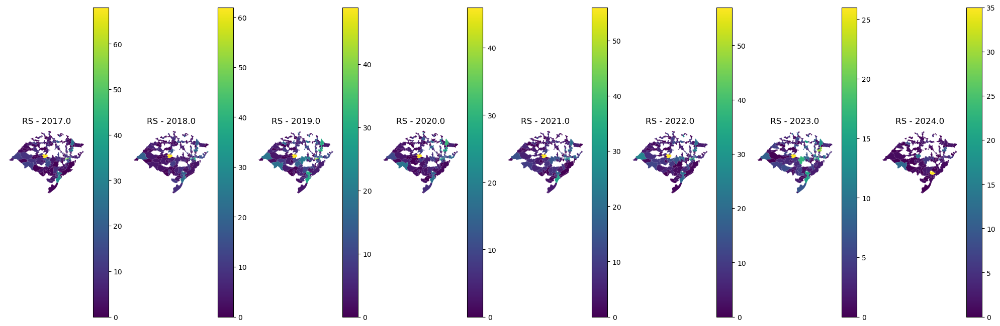

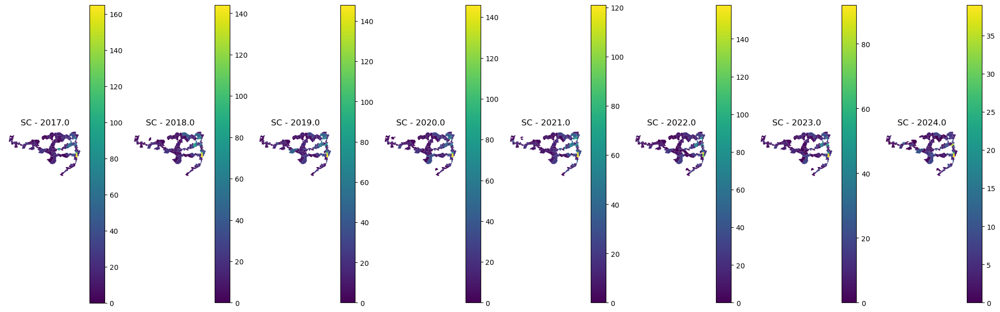

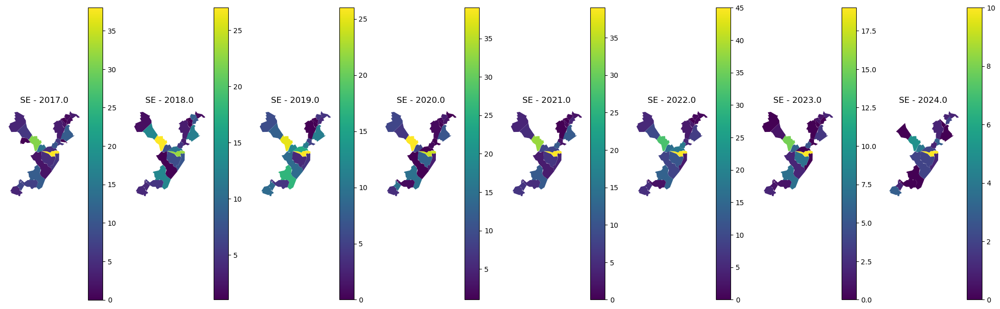

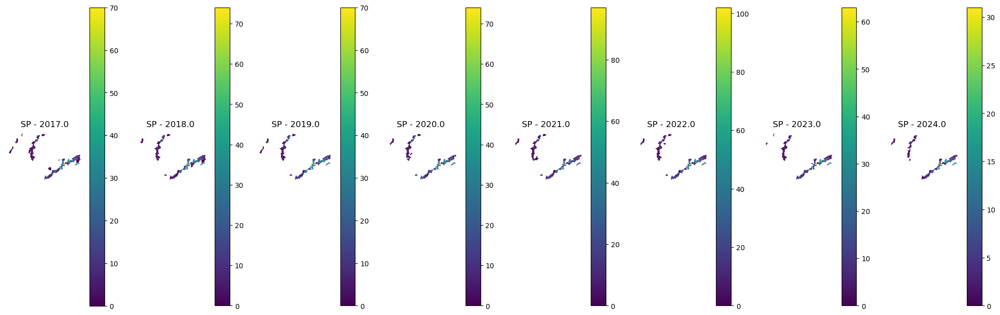

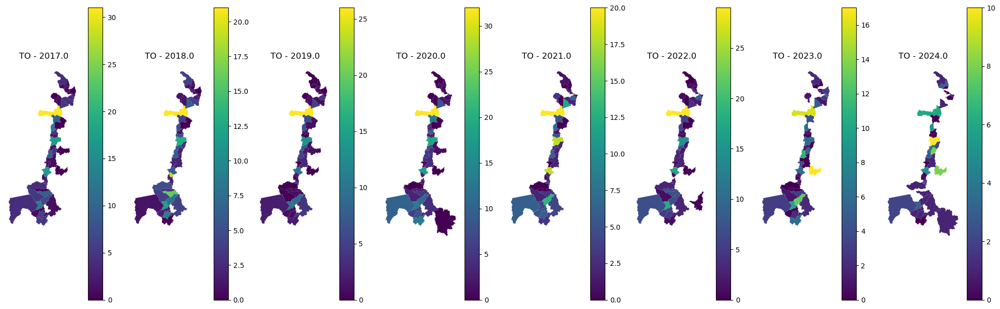

In [71]:
#Série histórica do número de feridos graves 2017-2024 por estado e muncípio

# Extrair o ano da coluna 'data_inversa'
geo_brasil_acidentes['year'] = geo_brasil_acidentes['data_inversa'].dt.year


geo_brasil_acidentes['feridos_graves'] = geo_brasil_acidentes['feridos_graves'].fillna(0)
    
geo_brasil_acidentes_grouped = geo_brasil_acidentes.groupby(['SIGLA_UF', 'year', 'NM_MUN']).agg({
    'feridos_graves': 'sum',
    'geometry': 'first'  # Preservar a geometria para plotagem
}).reset_index()

# Obter os anos únicos para plots lado a lado
anos = geo_brasil_acidentes_grouped['year'].unique()

# Loop por estado para gerar os mapas
estados = geo_brasil_acidentes_grouped['SIGLA_UF'].unique()
for estado in estados:
    # Preparar o subplot para cada ano
    fig, axs = plt.subplots(1, len(anos), figsize=(20, 10), sharex=True, sharey=True)
    
    for ax, ano in zip(axs, anos):
        # Filtrar o GeoDataFrame para o estado e ano atual
        gdf_estado_ano = geo_brasil_acidentes_grouped[(geo_brasil_acidentes_grouped['SIGLA_UF'] == estado) & (geo_brasil_acidentes_grouped['year'] == ano)]
        
    
        
        # Criar um GeoDataFrame temporário para plotar
        gdf_temp = gpd.GeoDataFrame(gdf_estado_ano, geometry='geometry')
        
        
        # Plotar
        gdf_temp.plot(
            column='feridos_graves',
            legend=True,
            cmap='viridis',
            #vmin=0,
            #vmax=5, 
            ax=ax
        )
        ax.set_title(f'{estado} - {ano}')
        ax.axis('off')  # Esconder os eixos se desejado
        
    # Ajustar layout
    plt.tight_layout()

    # Salvar o plot
    #plt.savefig(f'mapa_{estado}.png', bbox_inches='tight')

    # Exibir os plots
    plt.show()

    plt.close(fig)  # Fechar a figura após salvar para liberar memória

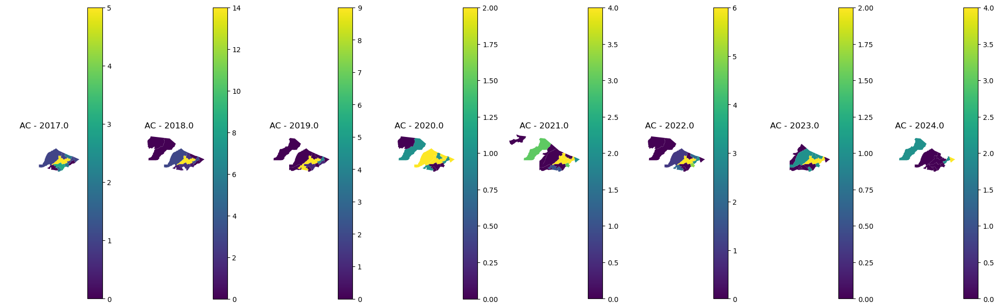

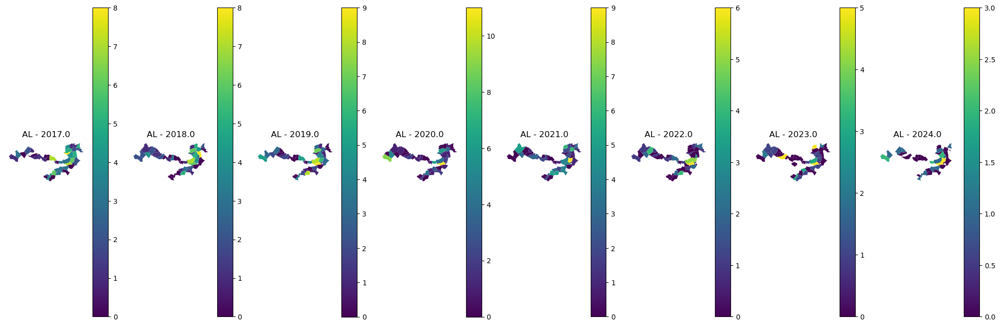

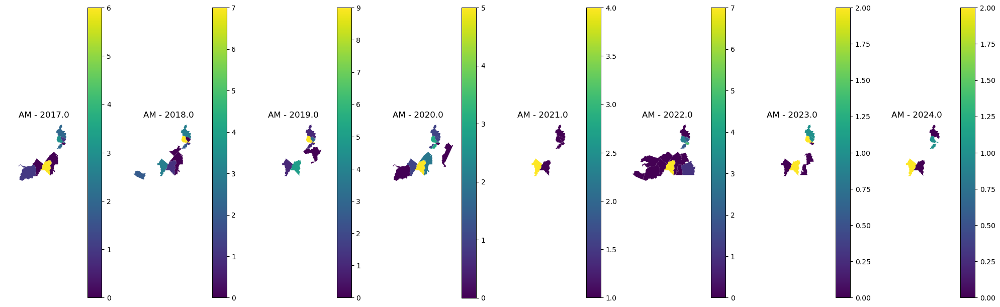

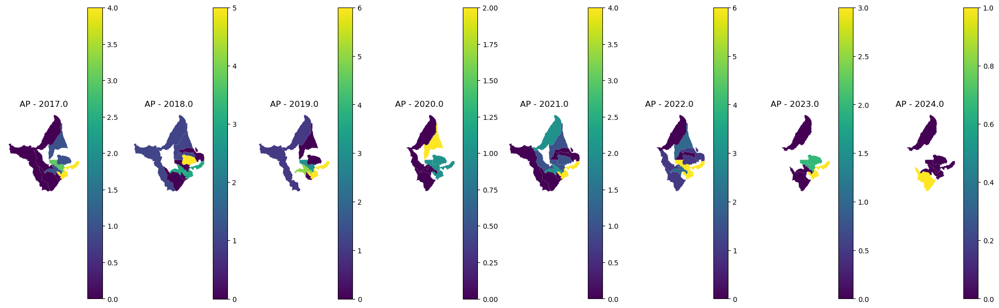

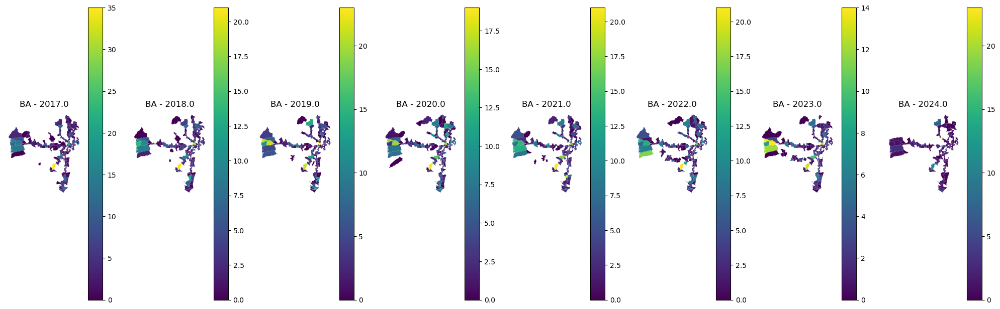

...

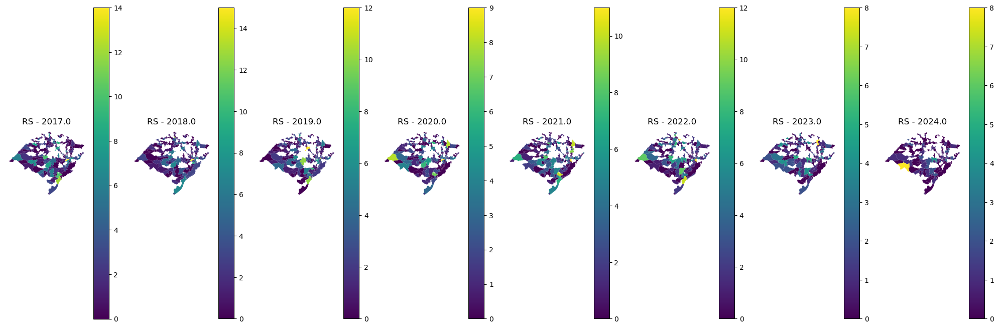

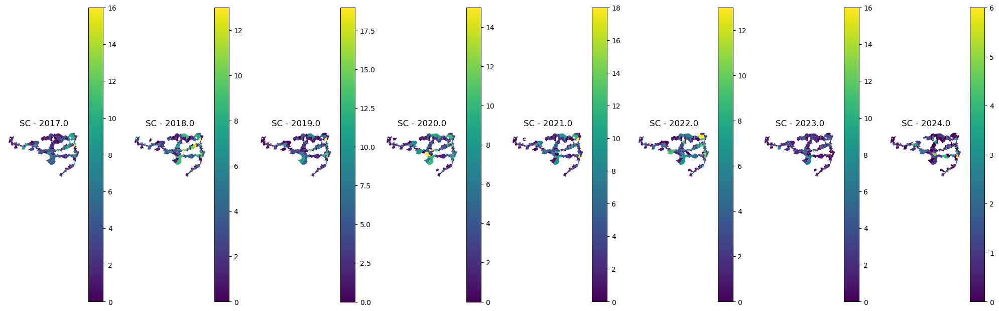

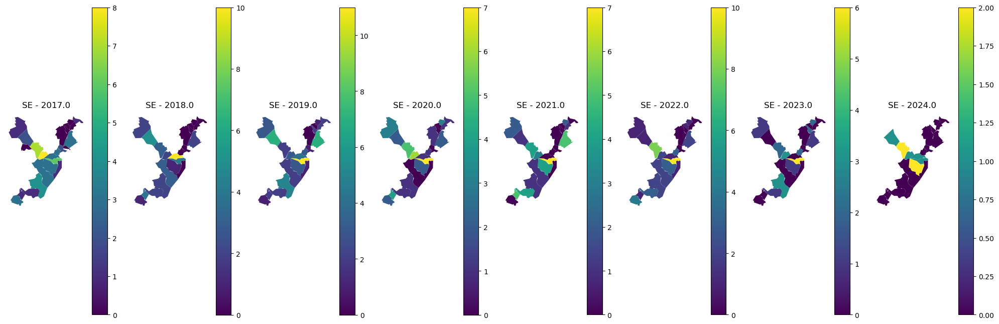

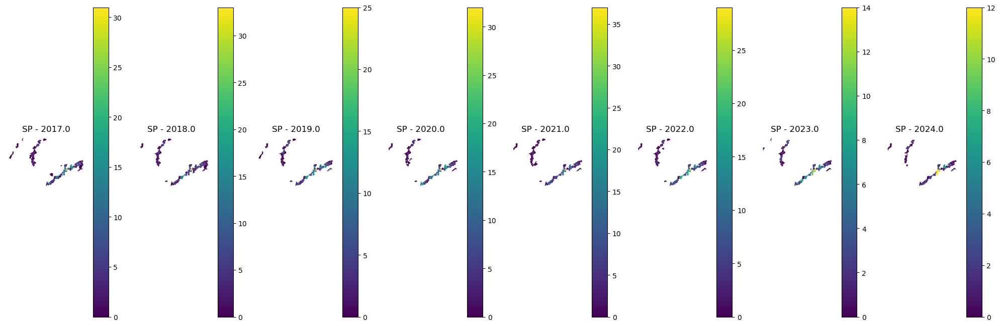

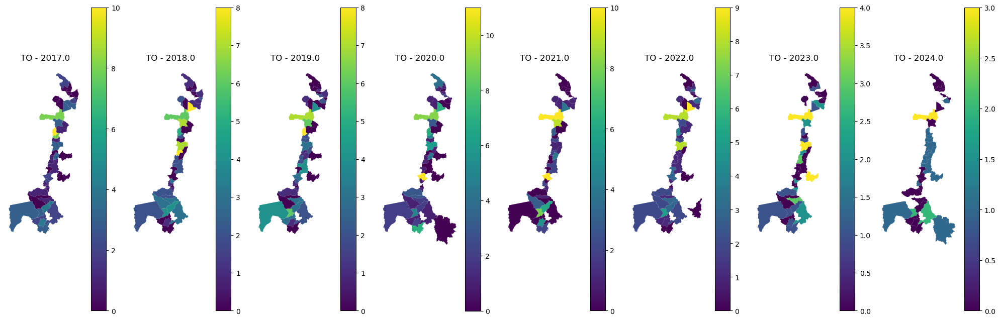

In [72]:
#Série histórica do número de mortos 2017-2024 por estado e muncípio

# Extrair o ano da coluna 'data_inversa'
geo_brasil_acidentes['year'] = geo_brasil_acidentes['data_inversa'].dt.year


geo_brasil_acidentes['mortos'] = geo_brasil_acidentes['mortos'].fillna(0)
    
geo_brasil_acidentes_grouped = geo_brasil_acidentes.groupby(['SIGLA_UF', 'year', 'NM_MUN']).agg({
    'mortos': 'sum',
    'geometry': 'first'  # Preservar a geometria para plotagem
}).reset_index()

# Obter os anos únicos para plots lado a lado
anos = geo_brasil_acidentes_grouped['year'].unique()

# Loop por estado para gerar os mapas
estados = geo_brasil_acidentes_grouped['SIGLA_UF'].unique()
for estado in estados:
    # Preparar o subplot para cada ano
    fig, axs = plt.subplots(1, len(anos), figsize=(20, 10), sharex=True, sharey=True)
    
    for ax, ano in zip(axs, anos):
        # Filtrar o GeoDataFrame para o estado e ano atual
        gdf_estado_ano = geo_brasil_acidentes_grouped[(geo_brasil_acidentes_grouped['SIGLA_UF'] == estado) & (geo_brasil_acidentes_grouped['year'] == ano)]
        
        # Criar um GeoDataFrame temporário para plotar
        gdf_temp = gpd.GeoDataFrame(gdf_estado_ano, geometry='geometry')
        
        # Plotar
        gdf_temp.plot(
            column='mortos',
            legend=True,
            cmap='viridis',
            #vmin=0,
            #vmax=5,  # Ajuste o vmax conforme necessário para sua escala de dados
            ax=ax
        )
        ax.set_title(f'{estado} - {ano}')
        ax.axis('off')  # Esconder os eixos se desejado
    
    # Ajustar layout
    plt.tight_layout()

    # Salvar o plot
    plt.savefig(f'mapa_{estado}.png', bbox_inches='tight')

    # Exibir os plots
    plt.show()

    plt.close(fig)  # Fechar a figura após salvar para liberar memória

# Índice de Moran

O Índice de Moran é uma medida de autocorrelação espacial global que indica se há um padrão de agrupamento ou dispersão de valores semelhantes em um espaço geográfico. Ele varia de -1 a +1, onde:

- +1 indica perfeita autocorrelação positiva: valores semelhantes estão agrupados juntos (por exemplo, áreas com renda alta cercadas por áreas com renda alta).
- 0 indica uma distribuição espacial aleatória.
- -1 indica perfeita autocorrelação negativa: valores semelhantes estão dispersos e rodeados por valores diferentes (por exemplo, áreas pobres rodeadas por áreas ricas).

Enquanto o Índice de Moran fornece uma medida global de autocorrelação, os gráficos LISA identificam padrões locais de autocorrelação espacial. Eles ajudam a localizar clusters de valores semelhantes ou discrepâncias espaciais. Cada localização é classificada em uma das quatro categorias:

- High-High (HH): valores altos cercados por valores altos.
- Low-Low (LL): valores baixos cercados por valores baixos.
- High-Low (HL): valores altos cercados por valores baixos.
- Low-High (LH): valores baixos cercados por valores altos.
- Não Signitivativos (NS): não há evidências suficientes para afirmar que este padrão é estatisticamente robusto e não apenas um resultado do acaso.

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\87760473.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 13 disconnected components.
 There are 10 islands with ids: 3, 5704, 6913, 13079, 13930, 14925, 20752, 21740, 31951, 31952.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 3, ' is an island (no neighbors)')
('WARNING: ', 5704, ' is an island (no neighbors)')
('WARNING: ', 6913, ' is an island (no neighbors)')
('WARNING: ', 13079, ' is an island (no neighbors)')
('WARNING: ', 13930, ' is an island (no neighbors)')
('WARNING: ', 14925, ' is an island (no neighbors)')
('WARNING: ', 20752, ' is an island (no neighbors)')
('WARNING: ', 21740, ' is an island (no neighbors)')
('WARNING: ', 31951, ' is an island (no neighbors)')
('WARNING: ', 31952, ' is an island (no neighbors)')


C:\Users\kaiog\anaconda3\Lib\site-packages\esda\moran.py:1059: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


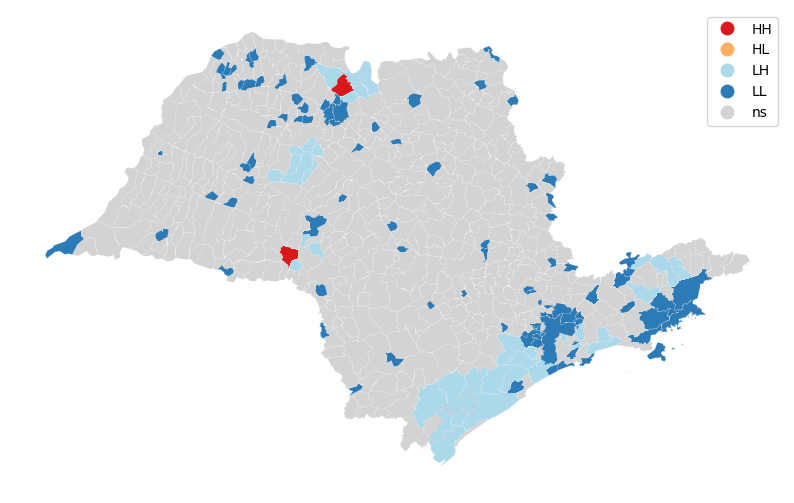

In [56]:
# Escolher o estado - correlação espacial de mortos
estado_selecionado = 'SP'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['mortos'] = amostra_pequena['mortos'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'mortos'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\741013993.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  W.__init__(self, neighbors, ids=ids, **kw)


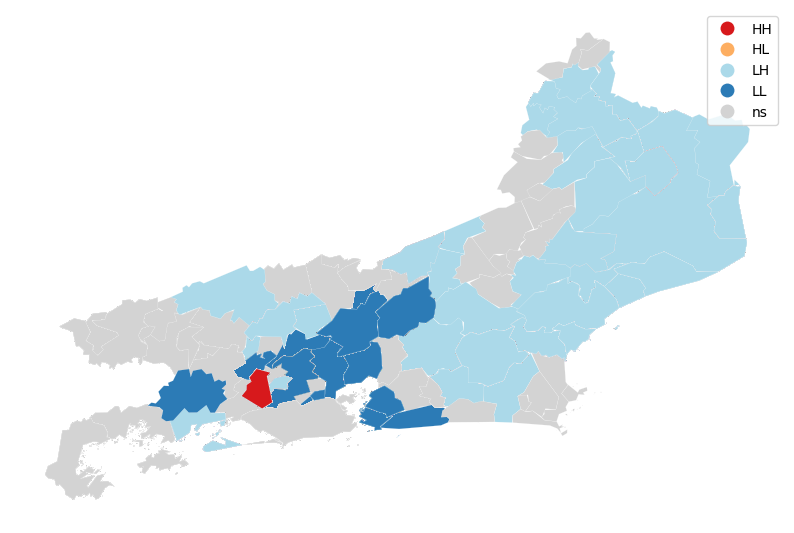

In [58]:
# Escolher o estado - correlação espacial de mortos
estado_selecionado = 'RJ' 

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['mortos'] = amostra_pequena['mortos'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'mortos'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\1296202486.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)


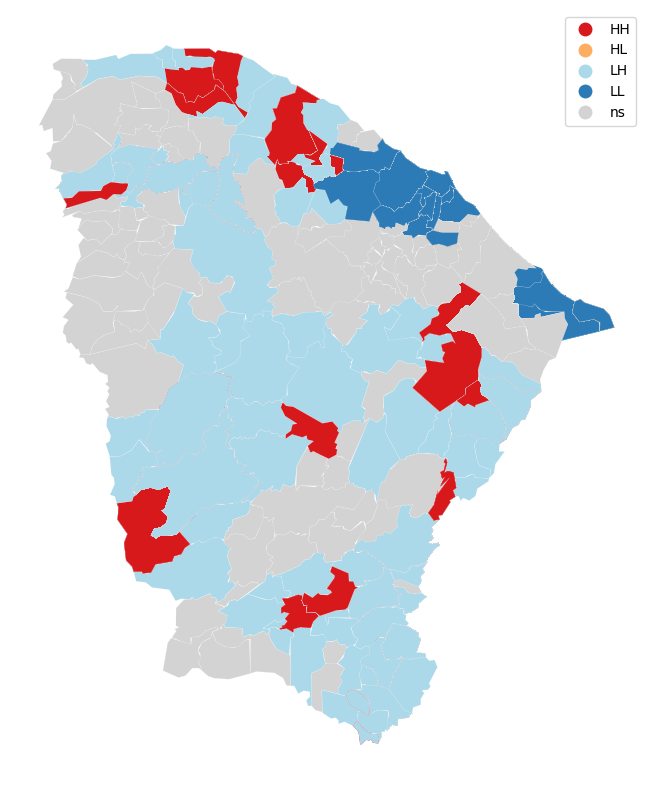

In [59]:
# Escolher o estado - correlação espacial de mortos
estado_selecionado = 'CE'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['mortos'] = amostra_pequena['mortos'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'mortos'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\1504060517.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There is 1 island with id: 13716.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 13716, ' is an island (no neighbors)')


C:\Users\kaiog\anaconda3\Lib\site-packages\esda\moran.py:1059: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


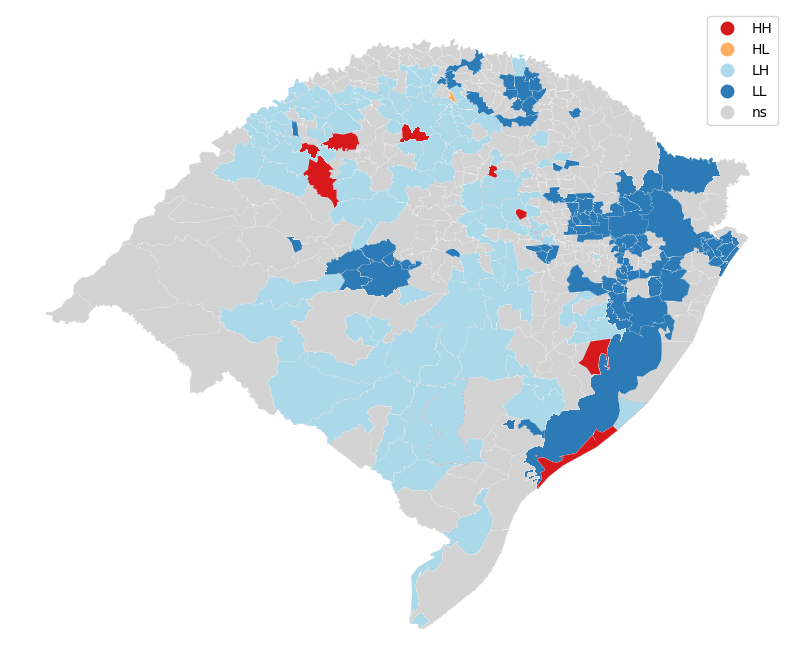

In [60]:
# Escolher o estado - correlação espacial de mortos
estado_selecionado = 'RS'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['mortos'] = amostra_pequena['mortos'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'mortos'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\3562648410.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 13 disconnected components.
 There are 10 islands with ids: 3, 5704, 6913, 13079, 13930, 14925, 20752, 21740, 31951, 31952.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 3, ' is an island (no neighbors)')
('WARNING: ', 5704, ' is an island (no neighbors)')
('WARNING: ', 6913, ' is an island (no neighbors)')
('WARNING: ', 13079, ' is an island (no neighbors)')
('WARNING: ', 13930, ' is an island (no neighbors)')
('WARNING: ', 14925, ' is an island (no neighbors)')
('WARNING: ', 20752, ' is an island (no neighbors)')
('WARNING: ', 21740, ' is an island (no neighbors)')
('WARNING: ', 31951, ' is an island (no neighbors)')
('WARNING: ', 31952, ' is an island (no neighbors)')


C:\Users\kaiog\anaconda3\Lib\site-packages\esda\moran.py:1059: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


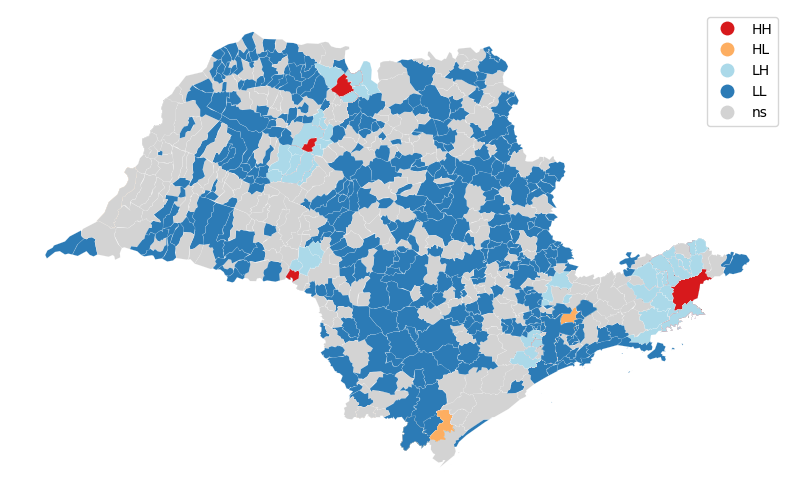

In [61]:
# Escolher o estado - correlação espacial de feridos graves
estado_selecionado = 'SP'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['feridos_graves'] = amostra_pequena['feridos_graves'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'feridos_graves'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\4205213627.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  W.__init__(self, neighbors, ids=ids, **kw)


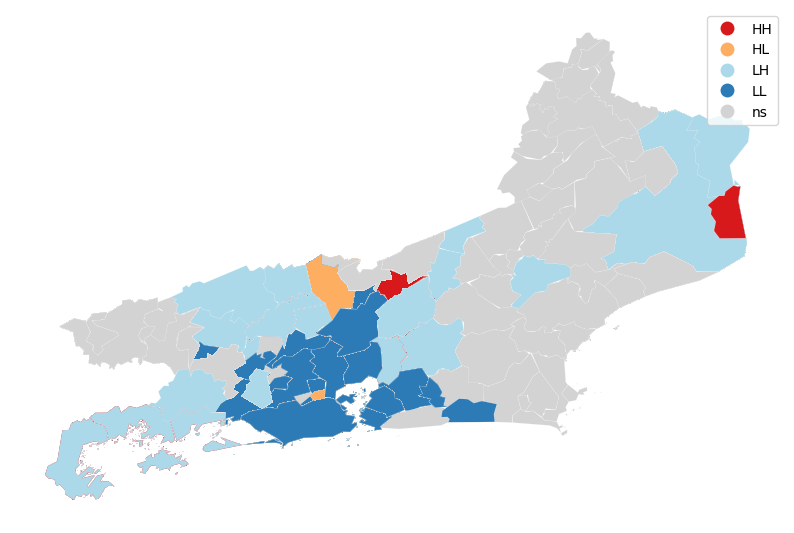

In [62]:
# Escolher o estado - correlação espacial de feridos graves
estado_selecionado = 'RJ'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['feridos_graves'] = amostra_pequena['feridos_graves'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'feridos_graves'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\1455279741.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)


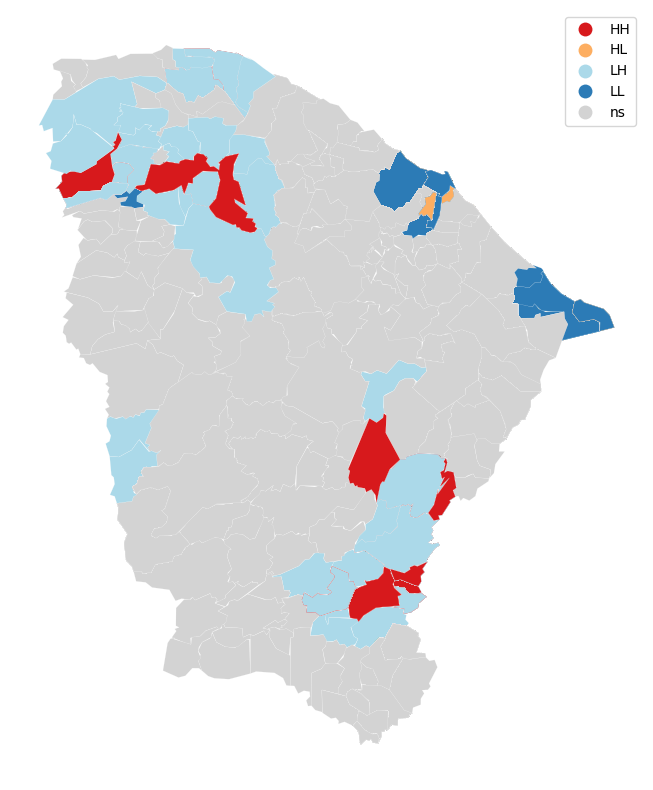

In [63]:
# Escolher o estado - correlação espacial de feridos graves
estado_selecionado = 'CE'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['feridos_graves'] = amostra_pequena['feridos_graves'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'feridos_graves'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

C:\Users\kaiog\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\kaiog\AppData\Local\Temp\ipykernel_7584\3870158221.py:15: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = weights.Queen.from_dataframe(amostra_pequena)
C:\Users\kaiog\anaconda3\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There is 1 island with id: 13716.
  W.__init__(self, neighbors, ids=ids, **kw)


('WARNING: ', 13716, ' is an island (no neighbors)')


C:\Users\kaiog\anaconda3\Lib\site-packages\esda\moran.py:1059: RuntimeWarning: invalid value encountered in divide
  self.z_sim = (self.Is - self.EI_sim) / self.seI_sim


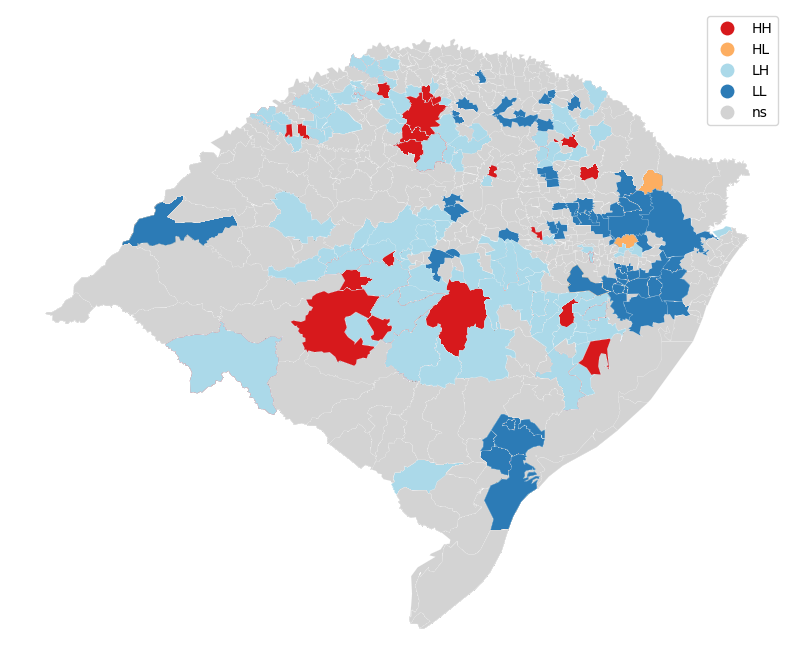

In [64]:
# Escolher o estado - correlação espacial de feridos graves
estado_selecionado = 'RS'  

# Filtrar o DataFrame pelo estado selecionado
amostra_pequena = geo_brasil_acidentes[geo_brasil_acidentes['SIGLA_UF'] == estado_selecionado]

# Verificar se a amostra não está vazia
if amostra_pequena.empty:
    print(f"Não há dados para o estado {estado_selecionado}.")
else:
    # Preencher valores NaN na coluna 'mortos'
    amostra_pequena['feridos_graves'] = amostra_pequena['feridos_graves'].fillna(0)

    # Calcular pesos espaciais - contiguidade de Queen
    w = weights.Queen.from_dataframe(amostra_pequena)
    w.transform = 'r'  # Transformação em pesos de linha

    # Calcular a autocorrelação espacial local
    data_column = 'feridos_graves'
    moran_loc = Moran_Local(amostra_pequena[data_column].values, w)

    # Plotar o resultado
    fig, ax = plt.subplots(figsize=(10, 10))
    lisa_cluster(moran_loc, amostra_pequena, p=0.05, ax=ax)  # p é o nível de significância
    plt.show()

In [18]:
#Exportando o geodatraframe para armazená-lo
# Mais de 1GB de dados, por isso, quando necessário utilizá-lo em máquina robusta
#Configuração recomendada: intel core 7-11370, 16GB de RAM, NVIDIA - RTX 3070
geo_brasil_acidentes.to_file('..\\Base de dados\\geodataframe\\geo_dataframe_datatran.geojson', driver='GeoJSON')